In [1]:
import numpy as np
import pandas as pd
import imageio
import os
from sklearn.metrics import matthews_corrcoef, accuracy_score, f1_score
# import higra as hg

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [2]:
import cv2
import sys
sys.path.append('../../resuneta/src')

from bound_dist import get_boundary

# Test set metrics

In [3]:
# shared function(s)
def get_mask(extent, boundary_kernel_size=(2,2)):
    boundary = get_boundary(extent, kernel_size=boundary_kernel_size)
    mask = np.array((extent + boundary) >= 1, dtype=np.uint8)
    return mask

## Airbus

In [4]:
def get_test_set_mcc(image_ids, pred_folder_name, 
                     label_folder_name='planet/india/GeneralBlockchain/extent_labels_',
                     fold='test', threshold=0.5):
    labels = []
    predictions = []
#     image_mccs = []

    for image_id in image_ids:
        if os.path.exists('../data/'+label_folder_name+'{}/airbus_geowiki_C{}.png'.format(fold, image_id)):
            extent = imageio.imread('../data/'+label_folder_name+'{}/airbus_geowiki_C{}.png'.format(fold, image_id))
            pred = np.load(os.path.join('../results/india/GeneralBlockchain/', 
                                        pred_folder_name,
                                        'extent_predictions',
                                        'airbus_geowiki_C{}.npy'.format(image_id)))

            mask = get_mask(extent)
            mask_flat = mask.flatten()

            indices = np.where(mask_flat == 1)[0]
            extent_flat = extent.flatten()
            field_and_border = extent_flat[indices]

            pred_flat = pred.flatten()
            prediction = pred_flat[indices]
            prediction = np.array(prediction > threshold, dtype=np.uint8)

    #         mcc = matthews_corrcoef(field_and_border, prediction)
    #         image_mccs.append(mcc)

            labels = labels + list(field_and_border)
            predictions = predictions + list(prediction)
        
    return matthews_corrcoef(labels, predictions)

In [5]:
splits_df = pd.read_csv('../data/splits/india_planetImagery_splits_20x20_v2.csv')
splits_df['image_id'] = splits_df['image_id'].astype(str).str.zfill(4)
# image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
image_ids = splits_df[splits_df['fold'] == 'val']['image_id'].values
splits_df.head()

,image_id,lat,lon,fold
0,0000,26.291410,73.095543,test
1,0115,26.008257,72.935907,test
2,0501,22.716429,82.110905,train
3,0781,22.557453,85.232995,test
4,0794,25.755859,82.609664,train


### Labels created via 1px erosion

#### Original France resolution

##### Applied to Airbus original

In [24]:
# trained on France original resolution separately, run #2
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.5, 0.7, 21)
for thresh in threshs:
    mcc = get_test_set_mcc(
        image_ids,
        'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-7_lr-0.001_1x-downsampled_allfields_n6759_1250px_thickness2/Airbus_original',
        label_folder_name='general_blockchain/airbus_labels/large/original_',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

In [25]:
print("Best MCC thresh:", threshs[np.argmax(mccs)])
print("Best val MCC:", np.max(mccs))

Best MCC thresh: 0.6499999999999999
Best val MCC: 0.37100977698434745


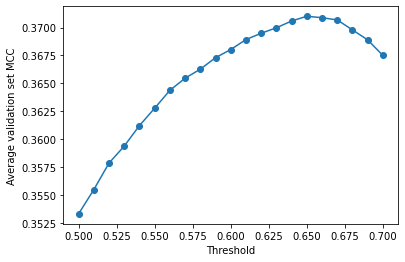

In [26]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()

In [27]:
# test set
fold = 'test'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mcc = get_test_set_mcc(
    image_ids,
    'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-7_lr-0.001_1x-downsampled_allfields_n6759_1250px_thickness2/Airbus_original',
    label_folder_name='general_blockchain/airbus_labels/large/original_',
    fold=fold,
    threshold=threshs[np.argmax(mccs)]
)
print("Test set MCC:", mcc)

Test set MCC: 0.3679502032847885


In [8]:
# trained on France original resolution separately
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.4, 0.8, 31)
for thresh in threshs:
    print(thresh)
    mcc = get_test_set_mcc(
        image_ids,
        'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_1x-downsampled_allfields_n6759/Airbus_original',
        label_folder_name='general_blockchain/airbus_labels/large/original_',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

0.4
0.41333333333333333
0.4266666666666667
0.44
0.45333333333333337
0.4666666666666667
0.48000000000000004
0.49333333333333335
0.5066666666666667
0.52
0.5333333333333333
0.5466666666666666
0.56
0.5733333333333334
0.5866666666666667
0.6000000000000001
0.6133333333333334
0.6266666666666667
0.64
0.6533333333333333
0.6666666666666667
0.68
0.6933333333333334
0.7066666666666668
0.72
0.7333333333333334
0.7466666666666667
0.76
0.7733333333333334
0.7866666666666667
0.8


In [10]:
np.max(mccs)

0.3228052425442077

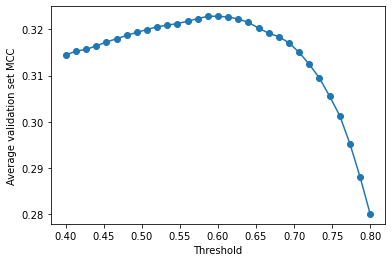

In [9]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()

##### Applied to Airbus 3x downsampled

In [12]:
# trained on France original resolution separately
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.4, 0.8, 31)
for thresh in threshs:
    mcc = get_test_set_mcc(
        image_ids,
        'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_1x-downsampled_allfields_n6759/Airbus_3x_downsampled',
        label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion1px_',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

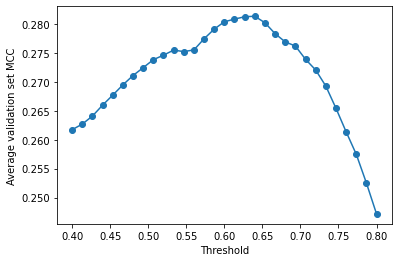

In [13]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()

In [17]:
# trained on France original resolution separately
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc(image_ids,
                 'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_1x-downsampled_allfields_n6759/Airbus_3x_downsampled',
                 label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion1px_', fold='test', threshold=0.64)

0.26152623997612157

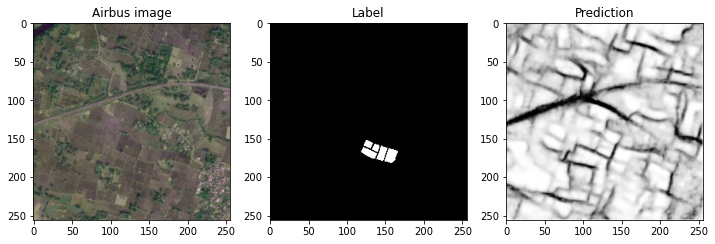

In [18]:
img = imageio.imread('../data/general_blockchain/airbus_false_color/large/3x_downsample_test/airbus_geowiki_C0006.png')
extent = imageio.imread('../data/general_blockchain/airbus_labels/large/3x_downsample_erosion1px_test/airbus_geowiki_C0006.png')
pred = np.load('../results/india/GeneralBlockchain/fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_1x-downsampled_allfields_n6759/Airbus_3x_downsampled/extent_predictions/airbus_geowiki_C0006.npy')

fig, ax = plt.subplots(1, 3, figsize=(12,4))
ax[0].imshow(img)
ax[1].imshow(extent, cmap='Greys_r', vmin=0, vmax=1)
ax[2].imshow(pred, cmap='Greys_r', vmin=0, vmax=1)
ax[0].set_title('Airbus image')
ax[1].set_title('Label')
ax[2].set_title('Prediction')
plt.show()

#### 2x+3x downsampled

In [21]:
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.5, 0.9, 41)
for thresh in threshs:
    mcc = get_test_set_mcc(
        image_ids,
        'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_2x-3x-downsampled_allfields_n6759/Airbus_3x_downsampled',
        label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion1px_',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

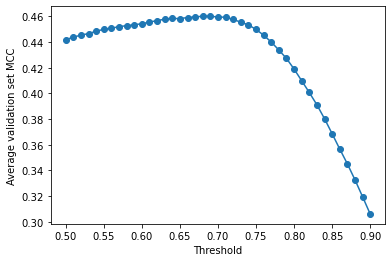

In [23]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()

In [25]:
# trained on France 2x+3x downsampled separately
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc(image_ids,
                 'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_2x-3x-downsampled_allfields_n6759/Airbus_3x_downsampled',
                 label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion1px_', fold='test', threshold=0.68)

0.4570279391136588

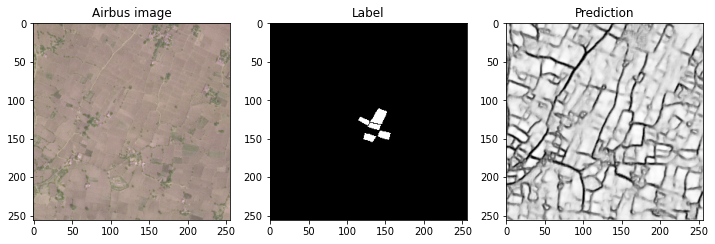

In [41]:
img = imageio.imread('../data/general_blockchain/airbus_false_color/large/3x_downsample_test/airbus_geowiki_C0007.png')
extent = imageio.imread('../data/general_blockchain/airbus_labels/large/3x_downsample_erosion1px_test/airbus_geowiki_C0007.png')
pred = np.load('../results/india/GeneralBlockchain/fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_2x-3x-downsampled_allfields_n6759/Airbus_3x_downsampled/extent_predictions/airbus_geowiki_C0007.npy')

fig, ax = plt.subplots(1, 3, figsize=(12,4))
ax[0].imshow(img)
ax[1].imshow(extent, cmap='Greys_r', vmin=0, vmax=1)
ax[2].imshow(pred, cmap='Greys_r', vmin=0, vmax=1)
ax[0].set_title('Airbus image')
ax[1].set_title('Label')
ax[2].set_title('Prediction')
plt.show()

#### Model: fine-tuned on 3x -- evaluate on original and 2x downsampled

In [13]:
# Tune threshold on original resolution
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.1, 0.3, 21)
for thresh in threshs:
    mcc = get_test_set_mcc(
        image_ids,
        'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_finetuned/Airbus_original',
        label_folder_name='general_blockchain/airbus_labels/large/original_',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

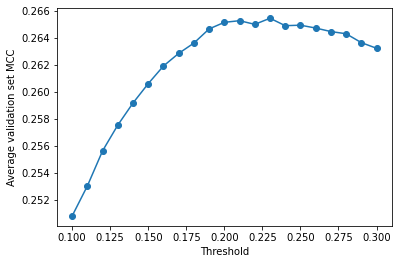

In [14]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()

In [17]:
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc(image_ids,
                 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_finetuned/Airbus_original',
                 label_folder_name='general_blockchain/airbus_labels/large/original_', 
                 fold='test', 
                 threshold=0.23)

0.27247048088232934

In [18]:
# Tune threshold on 2x downsampled
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.2, 0.5, 31)
for thresh in threshs:
    mcc = get_test_set_mcc(
        image_ids,
        'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled',
        label_folder_name='general_blockchain/airbus_labels/large/2x_downsample_erosion1px_',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

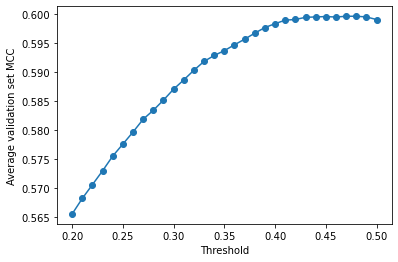

In [19]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()

In [20]:
threshs[np.argmax(mccs)]

0.48000000000000004

In [21]:
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc(image_ids,
                 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled',
                 label_folder_name='general_blockchain/airbus_labels/large/2x_downsample_erosion1px_', fold='test', threshold=0.48)

0.5987509830738632

#### Model: fine-tuned on 1x-3x -- evaluate on original and 2x downsampled

In [23]:
# Test on original resolution
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc(image_ids,
                 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_original',
                 label_folder_name='general_blockchain/airbus_labels/large/original_', 
                 fold='test', 
                 threshold=0.5)

0.4825629861802585

In [25]:
# Test on 2x downsampled
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc(image_ids,
                 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled',
                 label_folder_name='general_blockchain/airbus_labels/large/2x_downsample_erosion1px_', 
                 fold='test', 
                 threshold=0.5)

0.6378916603953253

In [26]:
# Test on 3x downsampled
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc(image_ids,
                 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled',
                 label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion2px_', 
                 fold='test', 
                 threshold=0.5)

0.6733180340203472

#### Model fine-tuned on 2x -- evaluate on original, 2x, and 3x

In [7]:
# Test on 2x downsampled
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc(image_ids,
                 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_2x-downsampled-erosion1px_finetuned/Airbus_2x_downsampled',
                 label_folder_name='general_blockchain/airbus_labels/large/2x_downsample_erosion1px_', 
                 fold='test', 
                 threshold=0.5)

0.6263378384666678

In [13]:
# Tune threshold on original resolution
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.3, 0.5, 11)
for thresh in threshs:
    mcc = get_test_set_mcc(
        image_ids,
        'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_2x-downsampled-erosion1px_finetuned/Airbus_original',
        label_folder_name='general_blockchain/airbus_labels/large/original_',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

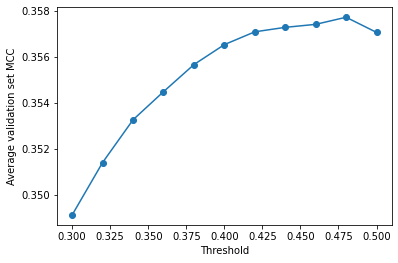

In [15]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()

In [14]:
threshs[np.argmax(mccs)]

0.48

In [16]:
# Test on original resolution
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc(image_ids,
                 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_2x-downsampled-erosion1px_finetuned/Airbus_original',
                 label_folder_name='general_blockchain/airbus_labels/large/original_', 
                 fold='test', 
                 threshold=threshs[np.argmax(mccs)])

0.36980794540868145

In [17]:
# Tune threshold on 3x downsampled
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.3, 0.6, 31)
for thresh in threshs:
    mcc = get_test_set_mcc(
        image_ids,
        'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_2x-downsampled-erosion1px_finetuned/Airbus_3x_downsampled',
        label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion2px_',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

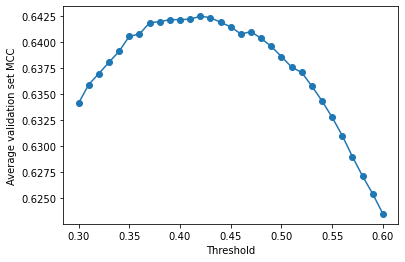

In [18]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()

In [19]:
threshs[np.argmax(mccs)]

0.42

In [20]:
# Test on 3x downsampled
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc(image_ids,
                 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled',
                 label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion2px_', 
                 fold='test', 
                 threshold=threshs[np.argmax(mccs)])

0.6689107959664604

#### Model trained on original resolution Airbus

In [23]:
# Test on original resolution
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc(image_ids,
                 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_original-resolution_finetuned/Airbus_original',
                 label_folder_name='general_blockchain/airbus_labels/large/original_', 
                 fold='test', 
                 threshold=0.5)

0.48665447786327687

In [24]:
# Tune threshold on 3x downsampled
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.4, 0.7, 31)
for thresh in threshs:
    mcc = get_test_set_mcc(
        image_ids,
        'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_original-resolution_finetuned/Airbus_3x_downsampled',
        label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion2px_',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

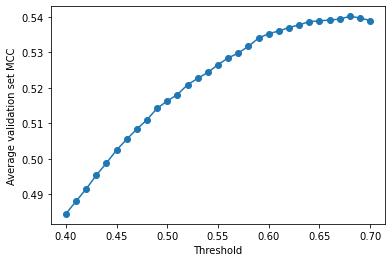

In [25]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()

In [26]:
threshs[np.argmax(mccs)]

0.6799999999999999

In [27]:
# Test on 3x downsampled
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc(image_ids,
                 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_original-resolution_finetuned/Airbus_3x_downsampled',
                 label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion2px_', 
                 fold='test', 
                 threshold=threshs[np.argmax(mccs)])

0.5217461673630429

In [28]:
# Tune threshold on 2x downsampled
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.4, 0.7, 31)
for thresh in threshs:
    mcc = get_test_set_mcc(
        image_ids,
        'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_original-resolution_finetuned/Airbus_2x_downsampled',
        label_folder_name='general_blockchain/airbus_labels/large/2x_downsample_erosion1px_',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

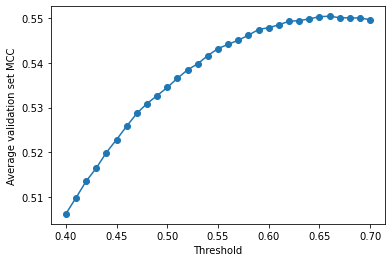

In [29]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()

In [30]:
threshs[np.argmax(mccs)]

0.6599999999999999

In [31]:
# Test on 2x downsampled
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc(image_ids,
                 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_original-resolution_finetuned/Airbus_2x_downsampled',
                 label_folder_name='general_blockchain/airbus_labels/large/2x_downsample_erosion1px_', 
                 fold='test', 
                 threshold=threshs[np.argmax(mccs)])

0.5476507326634276

### Labels created using 2px erosion

#### Original France resolution

In [28]:
# trained on France original resolution separately
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.4, 0.8, 31)
for thresh in threshs:
    mcc = get_test_set_mcc(
        image_ids,
        'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_1x-downsampled_allfields_n6759/Airbus_3x_downsampled',
        label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion2px_',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

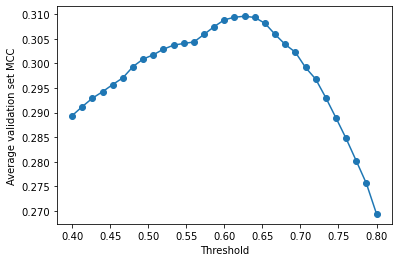

In [29]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()

In [30]:
np.array(threshs)[np.argmax(mccs)]

0.6266666666666667

In [31]:
# trained on France original resolution separately
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc(image_ids,
                 'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_1x-downsampled_allfields_n6759/Airbus_3x_downsampled',
                 label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion2px_', fold='test', threshold=0.63)

0.28939438071483536

#### 2x+3x downsampled

In [32]:
# trained on France original resolution separately
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.5, 0.9, 41)
for thresh in threshs:
    mcc = get_test_set_mcc(
        image_ids,
        'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_2x-3x-downsampled_allfields_n6759/Airbus_3x_downsampled',
        label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion2px_',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

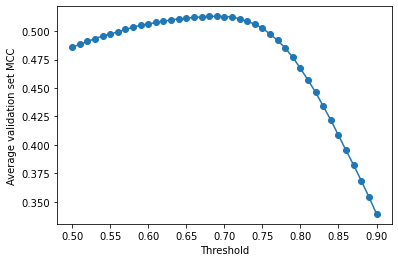

In [33]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()

In [34]:
np.array(threshs)[np.argmax(mccs)]

0.6799999999999999

In [35]:
# trained on France 2x+3x downsampled separately
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc(image_ids,
                 'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_2x-3x-downsampled_allfields_n6759/Airbus_3x_downsampled',
                 label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion2px_', fold='test', threshold=0.68)

0.5041242756424104

#### Fine-tuned in India

In [6]:
# finetuned in India
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.4, 0.8, 31)
for thresh in threshs:
    mcc = get_test_set_mcc(
        image_ids,
        'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/',
        label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion2px_',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

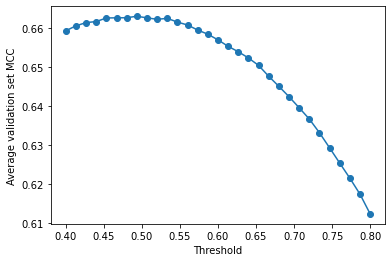

In [8]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()

In [7]:
np.array(threshs)[np.argmax(mccs)]

0.49333333333333335

In [10]:
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc(
    image_ids,
    'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/',
    label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion2px_', fold='test', threshold=0.49)

0.6545355326285097

#### Trained from scratch in India

In [9]:
# finetuned in India
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.4, 0.8, 31)
for thresh in threshs:
    mcc = get_test_set_mcc(
        image_ids,
        'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_fromscratch/Airbus_3x_downsampled/',
        label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion2px_',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

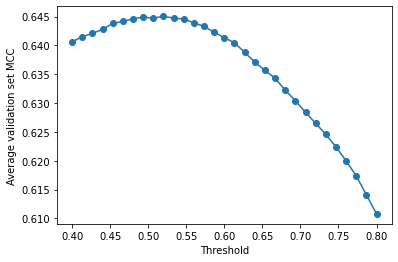

In [11]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()

In [12]:
np.array(threshs)[np.argmax(mccs)]

0.52

In [14]:
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc(
    image_ids,
    'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_fromscratch/Airbus_3x_downsampled/',
    label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion2px_', fold='test', threshold=0.52)

0.6402426066202103

## Dataset size experiment

In [32]:
# finetuned
fold = 'test'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
model_names = ['fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_n20_finetuned/',
               'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_n40_finetuned/',
               'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_n100_finetuned/',
               'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_n200_finetuned/',
               'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_n400_finetuned/',
               'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_n1000_finetuned/']
for model_name in model_names:
    mcc = get_test_set_mcc(
        image_ids,
        '{}/Airbus_3x_downsampled'.format(model_name),
        label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion2px_',
        fold=fold,
        threshold=0.5
    )
    np.save('../results/india/GeneralBlockchain/{}/testMCC.npy'.format(model_name), mcc)

In [31]:
# from scratch
fold = 'test'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
model_names = ['fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_n20_fromscratch-continued_finetuned/',
               'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_n40_fromscratch-continued/',
               'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_n100_fromscratch-continued/',
               'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_n200_fromscratch-continued/',
               'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_n400_fromscratch-continued/',
               'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_n1000_fromscratch/']
for model_name in model_names:
    mcc = get_test_set_mcc(
        image_ids,
        '{}/Airbus_3x_downsampled'.format(model_name),
        label_folder_name='general_blockchain/airbus_labels/large/3x_downsample_erosion2px_',
        fold=fold,
        threshold=0.5
    )
    np.save('../results/india/GeneralBlockchain/{}/testMCC.npy'.format(model_name), mcc)

## Planet: consensus

In [6]:
def get_test_set_mcc(image_ids, pred_folder_name, 
                     label_folder_name='planet/india/GeneralBlockchain/extent_labels_',
                     fold='test', threshold=0.5):
    labels = []
    predictions = []
#     image_mccs = []

    for image_id in image_ids:
        extent = imageio.imread('../data/'+label_folder_name+'{}/{}.png'.format(fold, image_id))
        pred = np.load(os.path.join('../results/india/GeneralBlockchain/', 
                                    pred_folder_name,
                                    'extent_predictions',
                                    '{}.npy'.format(image_id)))

        mask = get_mask(extent)
        mask_flat = mask.flatten()

        indices = np.where(mask_flat == 1)[0]
        extent_flat = extent.flatten()
        field_and_border = extent_flat[indices]

        pred_flat = pred.flatten()
        prediction = pred_flat[indices]
        prediction = np.array(prediction > threshold, dtype=np.uint8)

#         mcc = matthews_corrcoef(field_and_border, prediction)
#         image_mccs.append(mcc)

        labels = labels + list(field_and_border)
        predictions = predictions + list(prediction)
        
    return matthews_corrcoef(labels, predictions)

In [12]:
def get_test_set_metrics(image_ids, pred_folder_name, 
                     label_folder_name='planet/india/GeneralBlockchain/extent_labels_',
                     fold='test', threshold=0.5):
    labels = []
    predictions = []

    for image_id in image_ids:
        extent = imageio.imread('../data/'+label_folder_name+'{}/{}.png'.format(fold, image_id))
        pred = np.load(os.path.join('../results/india/GeneralBlockchain/', 
                                    pred_folder_name,
                                    'extent_predictions',
                                    '{}.npy'.format(image_id)))

        mask = get_mask(extent)
        mask_flat = mask.flatten()

        indices = np.where(mask_flat == 1)[0]
        extent_flat = extent.flatten()
        field_and_border = extent_flat[indices]

        pred_flat = pred.flatten()
        prediction = pred_flat[indices]
        prediction = np.array(prediction > threshold, dtype=np.uint8)

        labels = labels + list(field_and_border)
        predictions = predictions + list(prediction)
        
    return matthews_corrcoef(labels, predictions), accuracy_score(labels, predictions), f1_score(labels, predictions)

In [13]:
def get_individual_test_set_mcc(image_ids, pred_folder_name, 
                     label_folder_name='planet/india/GeneralBlockchain/extent_labels_',
                     fold='test', threshold=0.5):

    new_ids = []
    image_mccs = []
    image_accs = []
    image_f1s = []

    for image_id in image_ids:
        extent = imageio.imread('../data/'+label_folder_name+'{}/{}.png'.format(fold, image_id))
        pred = np.load(os.path.join('../results/india/GeneralBlockchain/', 
                                    pred_folder_name,
                                    'extent_predictions',
                                    '{}.npy'.format(image_id)))

        mask = get_mask(extent)
        mask_flat = mask.flatten()

        indices = np.where(mask_flat == 1)[0]
        extent_flat = extent.flatten()
        field_and_border = extent_flat[indices]

        pred_flat = pred.flatten()
        prediction = pred_flat[indices]
        prediction = np.array(prediction > threshold, dtype=np.uint8)

        mcc = matthews_corrcoef(field_and_border, prediction)
        acc = accuracy_score(field_and_border, prediction)
        f1 = f1_score(field_and_border, prediction)
            
        new_ids.append(image_id)
        image_mccs.append(mcc)
        image_accs.append(acc)
        image_f1s.append(f1)
        
    return new_ids, image_mccs, image_accs, image_f1s

In [10]:
splits_df = pd.read_csv('../data/splits/india_planetImagery_splits_20x20_v2.csv')
splits_df['image_id'] = splits_df['image_id'].astype(str).str.zfill(4)
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
# image_ids = splits_df[splits_df['fold'] == 'val']['image_id'].values
splits_df.head()

,image_id,lat,lon,fold
0,0000,26.291410,73.095543,test
1,0115,26.008257,72.935907,test
2,0501,22.716429,82.110905,train
3,0781,22.557453,85.232995,test
4,0794,25.755859,82.609664,train


In [11]:
# ==================== USER SETTINGS ==================== #
# trained on full france
model_name = 'full-france_fractal-resunet_3month-separate_nfilter-32_depth-6_bs-7_lr-0.001_1x-downsampled_allfields_n6759_1250px_thickness2'

# trained on 3-month separate France original resolution
# model_name = 'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_1x-downsampled_allfields_n6759'
# model_name = 'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-7_lr-0.001_1x-downsampled_allfields_n6759_1250px_thickness2/'

# trained on 3-month separate France 2x+3x downsampled
# model_name = 'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_2x-3x-downsampled_allfields_n6759'

# trained on 3-month separate France 2x+3x downsampled, finetuned on 12-month separate in India
# model_name = 'fractal-resunet_12month-separate_nfilter-32_bs-8_lr-0.001_2x-3x_downsampled_finetuned'

# trained from scratch on 12-month separate in India
# model_name = 'fractal-resunet_12month-separate_nfilter-32_depth-6_bs-8_lr-0.001_fromscratch'

# dataset size experiments
# model_name = 'fractal-resunet_12month-separate_nfilter-32_bs-8_lr-0.001_n400_finetuned/'
# model_name = 'fractal-resunet_12month-separate_nfilter-32_depth-6_bs-8_lr-0.001_n200_fromscratch/'
# ======================================================= #

base_dir = '../results/india/GeneralBlockchain/{}'.format(model_name)
# months = ['2020_{}'.format(str(x).zfill(2)) for x in range(8, 13)] + \
#          ['2021_{}'.format(str(x).zfill(2)) for x in range(1, 8)]
months = ['2020_10', '2020_12', '2021_02']

for subfolder in ['extent_predictions', 'boundary_predictions']:
    consensus_dir = os.path.join(base_dir, 'consensus_OctDecFeb', subfolder)

    if not os.path.exists(consensus_dir):
        os.makedirs(consensus_dir)

    plot = False
    if plot:
        fig, ax = plt.subplots(4, 4, figsize=(16, 16))

    for image_id in image_ids:
        pred = np.zeros((len(months), 256, 256))
        for m, month in enumerate(months):
            pred_month = np.load('../results/india/GeneralBlockchain/{}/{}/{}/{}_{}.npy'.format(
                model_name, month, subfolder, image_id, month))
            pred[m] = pred_month

            if plot:
                r = m // 4
                c = m % 4
                ax[r,c].imshow(pred_month, cmap='Greys_r')

        pred_consensus = np.mean(pred, axis=0)

        if plot:
            ax[-1,0].imshow(pred_consensus, cmap='Greys_r')
            plt.show()

        np.save(os.path.join(consensus_dir, image_id + '.npy'), pred_consensus)

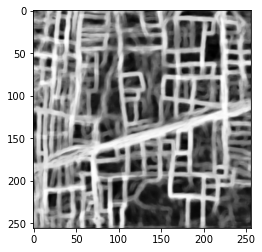

In [129]:
plt.imshow(pred_consensus, cmap='Greys_r')
plt.show()

## MCC for entire test set

#### Tune threshold on validation set

##### 3-month consensus

In [14]:
# trained on FULL France original resolution separately
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.5, 0.7, 21)
for thresh in threshs:
    print(thresh)
    mcc = get_test_set_mcc(
        image_ids,
        'full-france_fractal-resunet_3month-separate_nfilter-32_depth-6_bs-7_lr-0.001_1x-downsampled_allfields_n6759_1250px_thickness2/consensus_OctDecFeb',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

0.5
0.51
0.52
0.53
0.54
0.55
0.5599999999999999
0.57
0.58
0.59
0.6
0.61
0.62
0.63
0.64
0.6499999999999999
0.6599999999999999
0.6699999999999999
0.6799999999999999
0.69
0.7


In [15]:
np.array(threshs)[np.argmax(mccs)]

0.5599999999999999

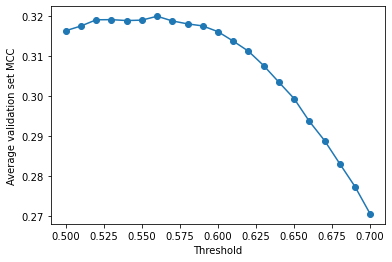

In [16]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()
# best threshold on test set = 0.65
# best MCC at best threshold = 0.3969

In [19]:
# test set
fold = 'test'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mcc, acc, f1 = get_test_set_metrics(
    image_ids,
    'full-france_fractal-resunet_3month-separate_nfilter-32_depth-6_bs-7_lr-0.001_1x-downsampled_allfields_n6759_1250px_thickness2/consensus_OctDecFeb',
    fold=fold,
    threshold=0.56
)
print("Test set MCC: {:0.4f}, acc: {:0.3f}, f1: {:0.3f}".format(mcc, acc, f1))

Test set MCC: 0.3150, acc: 0.741, f1: 0.829


In [10]:
# trained on France original resolution separately, run #2
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.5, 0.7, 21)
for thresh in threshs:
    mcc = get_test_set_mcc(
        image_ids,
        'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-7_lr-0.001_1x-downsampled_allfields_n6759_1250px_thickness2/consensus_OctDecFeb',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

In [11]:
np.array(threshs)[np.argmax(mccs)]

0.6499999999999999

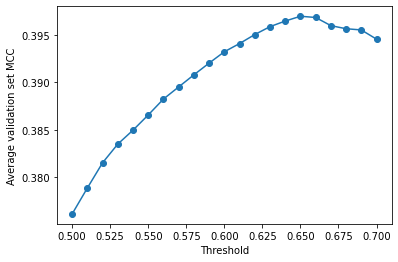

In [18]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()
# best threshold on test set = 0.65
# best MCC at best threshold = 0.3969

In [21]:
# test set
fold = 'test'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mcc = get_test_set_mcc(
    image_ids,
    'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-7_lr-0.001_1x-downsampled_allfields_n6759_1250px_thickness2/consensus_OctDecFeb',
    fold=fold,
    threshold=0.65
)
print("Test set MCC:", mcc)

Test set MCC: 0.3631004312722491


In [191]:
# trained on France original resolution separately
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.5, 0.7, 21)
for thresh in threshs:
    mcc = get_test_set_mcc(
        'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_1x-downsampled_allfields_n6759/consensus_OctDecFeb',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

In [193]:
np.array(threshs)[np.argmax(mccs)]

0.63

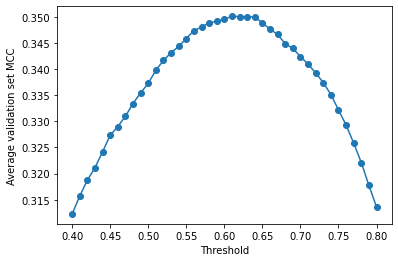

In [188]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()
# best threshold on test set = 0.61
# best MCC at best threshold = 0.350098

In [194]:
# trained on France 2x+3x downsampled separately
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.7, 0.9, 21)
for thresh in threshs:
    mcc = get_test_set_mcc(
        'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_2x-3x-downsampled_allfields_n6759/consensus_OctDecFeb',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

In [196]:
np.array(threshs)[np.argmax(mccs)]

0.74

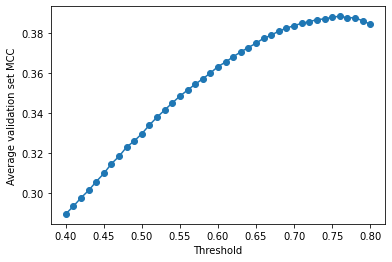

In [180]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()
# best threshold on test set = 0.76
# best MCC at best threshold = 0.388586

In [22]:
# finetuned in India
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.5, 0.8, 31)
for thresh in threshs:
    mcc = get_test_set_mcc(
        image_ids,
        'fractal-resunet_12month-separate_nfilter-32_bs-8_lr-0.001_2x-3x_downsampled_finetuned/consensus',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

In [24]:
np.array(threshs)[np.argmax(mccs)]

0.5900000000000001

In [21]:
# test set
fold = 'test'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mcc = get_test_set_mcc(
    image_ids,
    'fractal-resunet_12month-separate_nfilter-32_bs-8_lr-0.001_2x-3x_downsampled_finetuned/consensus',
    fold=fold,
    threshold=0.59
)

In [25]:
print("Test set MCC: {}".format(mcc))

Test set MCC: 0.520326921938791


In [14]:
# test set
fold = 'test'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
new_ids, mccs, accs, f1s = get_individual_test_set_mcc(
    image_ids,
    'fractal-resunet_12month-separate_nfilter-32_bs-8_lr-0.001_2x-3x_downsampled_finetuned/consensus',
    fold=fold,
    threshold=0.59
)

/home/swang222/anaconda3/envs/mxnet1.6.0/lib/python3.6/site-packages/sklearn/metrics/_classification.py:846: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


In [15]:
mcc_df = pd.DataFrame({
    'image_id': new_ids,
    'mcc': mccs,
    'acc': accs,
    'f1': f1s
})
mcc_df.to_csv('../results/india/GeneralBlockchain/fractal-resunet_12month-separate_nfilter-32_bs-8_lr-0.001_2x-3x_downsampled_finetuned/consensus/MCC.csv', index=False)

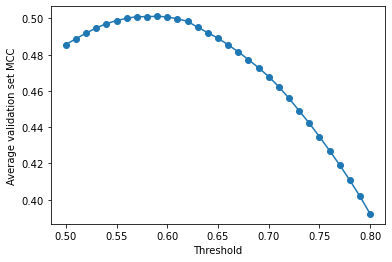

In [23]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()
# best threshold on test set = 0.59
# best MCC at best threshold = 0.52

In [27]:
# trained from scratch in India
fold = 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.5, 0.8, 31)
for thresh in threshs:
    mcc = get_test_set_mcc(
        image_ids,
        'fractal-resunet_12month-separate_nfilter-32_depth-6_bs-8_lr-0.001_fromscratch/consensus_OctDecFeb/',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

In [29]:
np.array(threshs)[np.argmax(mccs)]

0.5900000000000001

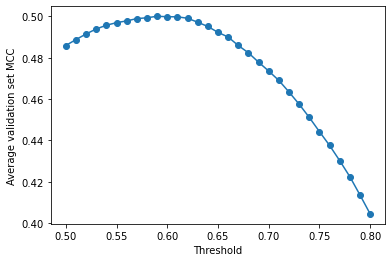

In [28]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()
# best threshold on test set = 0.59
# best MCC at best threshold = 0.52

##### 3-month stack

In [210]:
# trained on France 2x+3x downsampled stacked
fold = 'test'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
mccs = []
threshs = np.linspace(0.5, 0.7, 21)
for thresh in threshs:
    mcc = get_test_set_mcc(
        'fractal-resunet_3month-stacked-shuffled_nfilter-32_depth-6_bs-6_lr-0.001_2x-3x-downsampled_fromscratch/',
        fold=fold,
        threshold=thresh
    )
    mccs.append(mcc)

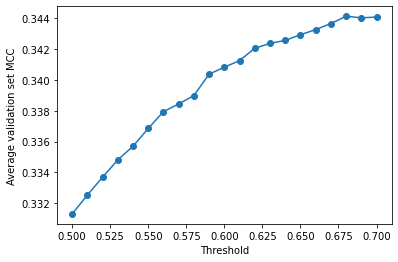

In [211]:
plt.plot(threshs, mccs, 'o-')
plt.xlabel('Threshold')
plt.ylabel('Average validation set MCC')
plt.show()
# best threshold on test set = 
# best MCC at best threshold = 

In [212]:
np.max(mccs)

0.3441375223693795

In [213]:
np.array(threshs)[np.argmax(mccs)]

0.6799999999999999

In [216]:
np.argmax(mccs)

18

## Dataset size experiments

In [11]:
# finetuned
fold = 'test'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
model_names = ['fractal-resunet_12month-separate_nfilter-32_bs-8_lr-0.001_n{}_finetuned'.format(n) for n in [400]] # 20, 40, 100, 200, 400, 1000
for model_name in model_names:
    mcc = get_test_set_mcc(
        image_ids,
        '{}/consensus_OctDecFeb/'.format(model_name),
        fold=fold,
        threshold=0.5
    )
    np.save('../results/india/GeneralBlockchain/{}/consensus_OctDecFeb_testMCC.npy'.format(model_name), mcc)

In [29]:
# from scratch
fold = 'test'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
model_names = ['fractal-resunet_12month-separate_nfilter-32_depth-6_bs-8_lr-0.001_n{}_fromscratch/'.format(n) for n in [20, 40, 100, 200, 400, 1000]]
for model_name in model_names:
    mcc = get_test_set_mcc(
        image_ids,
        '{}/consensus_OctDecFeb/'.format(model_name),
        fold=fold,
        threshold=0.5
    )
    np.save('../results/india/GeneralBlockchain/{}/consensus_OctDecFeb_testMCC.npy'.format(model_name), mcc)

#### 12 months separately

In [92]:
# trained on France original resolution separately
get_test_set_mcc('fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_1x-downsampled_allfields_n6759/consensus')

0.3344434913573551

In [93]:
# trained on France 2x+3x downsampled separately
get_test_set_mcc('fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_2x-3x-downsampled_allfields_n6759/consensus')

0.30062357856030064

In [85]:
# trained on France 2x+3x downsampled separately, finetuned on 12-month India separately
get_test_set_mcc('fractal-resunet_12month-separate_nfilter-32_bs-8_lr-0.001_2x-3x_downsampled_finetuned/consensus')

0.4950401276065205

In [89]:
# trained on 12-month India separately from scratch
get_test_set_mcc('fractal-resunet_12month-separate_nfilter-32_depth-6_bs-8_lr-0.001_fromscratch/consensus')

0.48575610741930575

#### 3 month consensus

In [200]:
# trained on France original resolution separately
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc('fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_1x-downsampled_allfields_n6759/consensus_OctDecFeb',
                 threshold=0.63)

0.3500053131797072

In [199]:
# trained on France 2x+3x downsampled separately
image_ids = splits_df[splits_df['fold'] == 'test']['image_id'].values
get_test_set_mcc('fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_2x-3x-downsampled_allfields_n6759/consensus_OctDecFeb', 
                 threshold=0.74)

0.3872239718968497

#### Why is original resolution doing better than 2x-3x downsampled?

In [64]:
image_mccs_1x, mean_field_sizes = get_image_mccs(
    'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_1x-downsampled_allfields_n6759/consensus_OctDecFeb',
    threshold=0.63
)

image_mccs_2x3x, mean_field_sizes = get_image_mccs(
    'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_2x-3x-downsampled_allfields_n6759/consensus_OctDecFeb',
    threshold=0.74
)

/home/swang222/anaconda3/envs/mxnet1.6.0/lib/python3.6/site-packages/sklearn/metrics/_classification.py:846: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


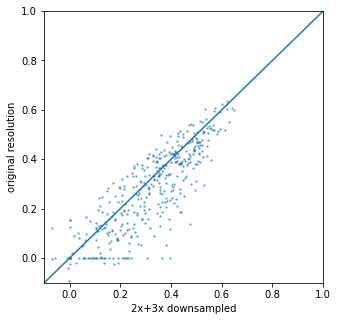

In [203]:
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
plt.scatter(image_mccs_2x3x, image_mccs_1x, s=2, alpha=0.5)
plt.xlabel('2x+3x downsampled')
plt.ylabel('original resolution')
plt.plot([-0.1, 1.0], [-0.1, 1.0])
plt.xlim([-0.1, 1.0])
plt.ylim([-0.1, 1.0])
plt.show()

In [ ]:
orig_res_better = np.where(np.array(image_mccs_1x) > np.array(image_mccs_2x3x))[0]
for i, image_id in enumerate(image_ids[orig_res_better]):
    pred_1x = np.load('../results/india/GeneralBlockchain/fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_1x-downsampled_allfields_n6759/consensus_OctDecFeb/extent_predictions/{}.npy'.format(image_id))
    pred_2x3x = np.load('../results/india/GeneralBlockchain/fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_2x-3x-downsampled_allfields_n6759/consensus_OctDecFeb/extent_predictions/{}.npy'.format(image_id))
    label = imageio.imread('../data/planet/india/GeneralBlockchain/extent_labels_test/{}.png'.format(image_id))
    
    fig, ax = plt.subplots(1, 5, figsize=(25, 5))
    ax[0].imshow(label, cmap='Greys_r')
    ax[0].set_title('Label for image {}'.format(image_id))
    ax[1].imshow(pred_1x, cmap='Greys_r')
    ax[1].set_title('Original resolution prediction\nMCC={:0.2f}'.format(np.array(image_mccs_1x)[orig_res_better[i]]))
    ax[2].imshow(pred_1x > 0.63, cmap='Greys_r')
    ax[2].set_title('Original resolution binary\nMCC={:0.2f}'.format(np.array(image_mccs_1x)[orig_res_better[i]]))
    ax[3].imshow(pred_2x3x, cmap='Greys_r')
    ax[3].set_title('2x+3x downsampled prediction\nMCC={:0.2f}'.format(np.array(image_mccs_2x3x)[orig_res_better[i]]))
    ax[4].imshow(pred_2x3x > 0.76, cmap='Greys_r')
    ax[4].set_title('2x+3x downsampled binary\nMCC={:0.2f}'.format(np.array(image_mccs_2x3x)[orig_res_better[i]]))
    plt.show()

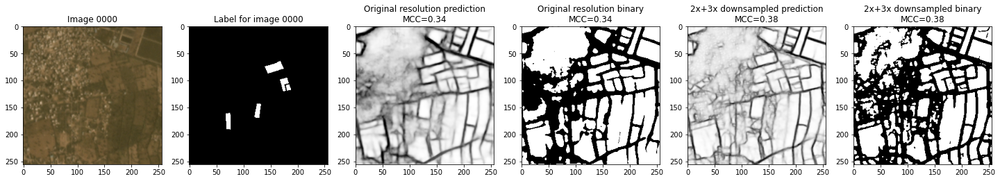

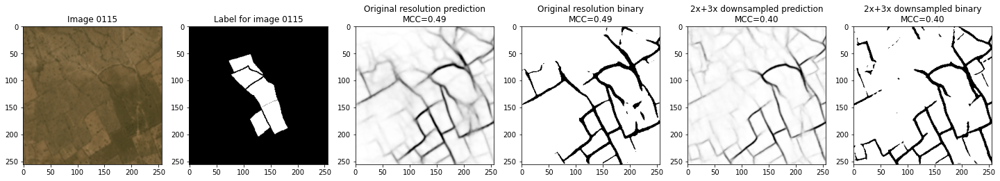

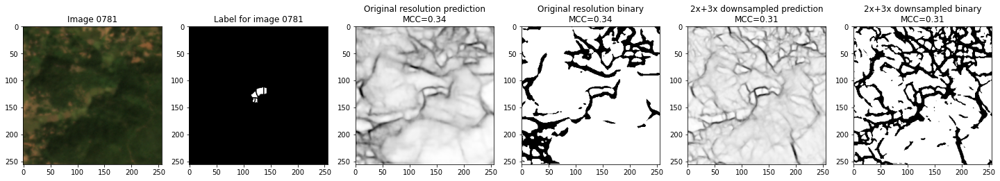

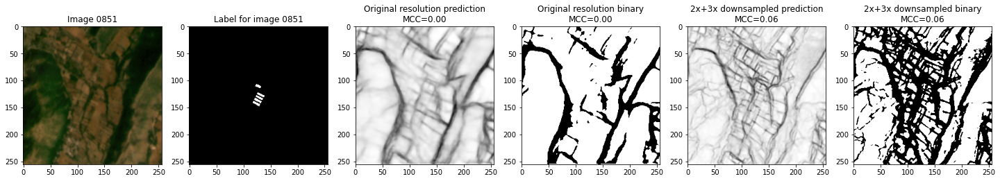

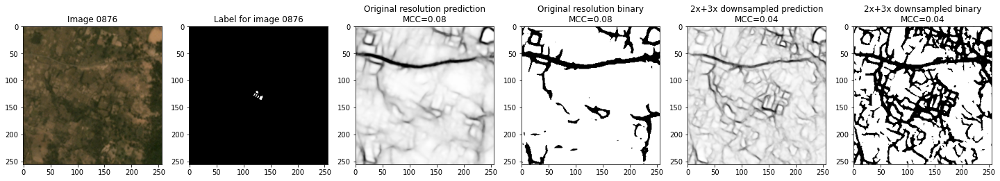

...

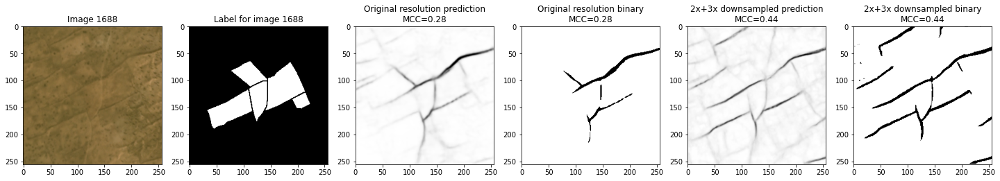

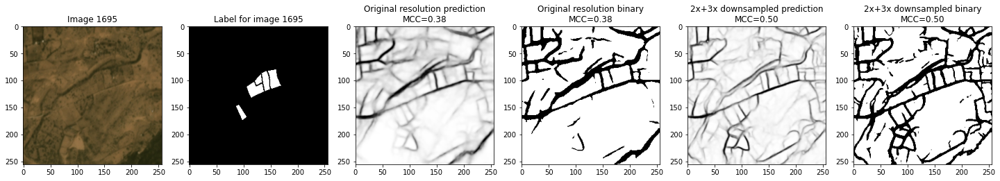

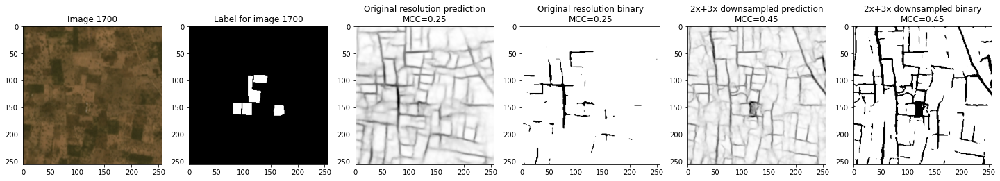

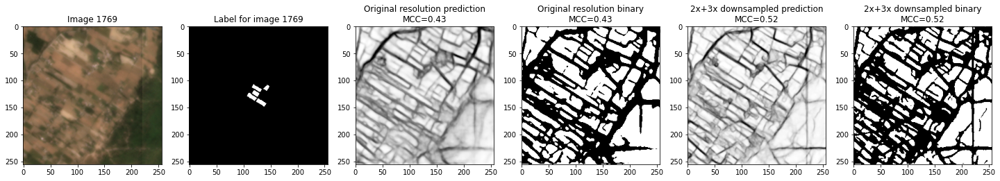

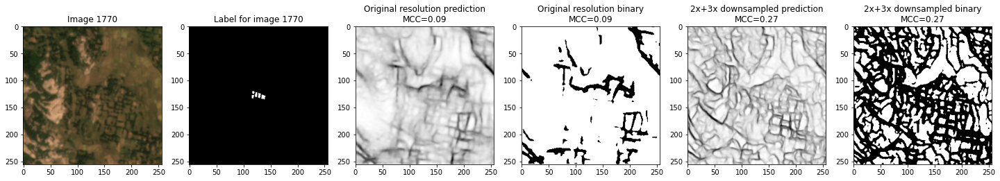

KeyboardInterrupt: 

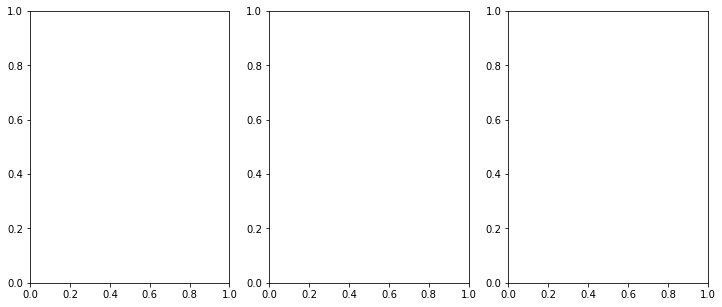

In [69]:
for i, image_id in enumerate(image_ids):
    img = imageio.imread('../data/planet/india/GeneralBlockchain/monthly_mosaics_renamed_clipped_merged_test/2020_10/{}_2020_10.tif'.format(image_id))
    pred_1x = np.load('../results/india/GeneralBlockchain/fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_1x-downsampled_allfields_n6759/consensus_OctDecFeb/extent_predictions/{}.npy'.format(image_id))
    pred_2x3x = np.load('../results/india/GeneralBlockchain/fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_2x-3x-downsampled_allfields_n6759/consensus_OctDecFeb/extent_predictions/{}.npy'.format(image_id))
    label = imageio.imread('../data/planet/india/GeneralBlockchain/extent_labels_test/{}.png'.format(image_id))
    
    fig, ax = plt.subplots(1, 6, figsize=(25, 5))
    ax[0].imshow(img)
    ax[0].set_title('Image {}'.format(image_id))
    ax[1].imshow(label, cmap='Greys_r')
    ax[1].set_title('Label for image {}'.format(image_id))
    ax[2].imshow(pred_1x, cmap='Greys_r')
    ax[2].set_title('Original resolution prediction\nMCC={:0.2f}'.format(np.array(image_mccs_1x)[i]))
    ax[3].imshow(pred_1x > 0.63, cmap='Greys_r')
    ax[3].set_title('Original resolution binary\nMCC={:0.2f}'.format(np.array(image_mccs_1x)[i]))
    ax[4].imshow(pred_2x3x, cmap='Greys_r')
    ax[4].set_title('2x+3x downsampled prediction\nMCC={:0.2f}'.format(np.array(image_mccs_2x3x)[i]))
    ax[5].imshow(pred_2x3x > 0.76, cmap='Greys_r')
    ax[5].set_title('2x+3x downsampled binary\nMCC={:0.2f}'.format(np.array(image_mccs_2x3x)[i]))
    plt.show()

#### 1 month (Dec)

In [136]:
# trained on France 2x+3x downsampled separately
labels = []
predictions = []

for image_id in image_ids:
    extent = imageio.imread('../data/planet/india/GeneralBlockchain/extent_labels_test/{}.png'.format(image_id))
    pred = np.load(os.path.join('../results/india/GeneralBlockchain/', 
                                'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_2x-3x-downsampled_allfields_n6759/2020_12',
                                'extent_predictions',
                                '{}_2020_12.npy'.format(image_id)))

    mask = get_mask(extent)
    mask_flat = mask.flatten()

    indices = np.where(mask_flat == 1)[0]
    extent_flat = extent.flatten()
    field_and_border = extent_flat[indices]

    pred_flat = pred.flatten()
    prediction = pred_flat[indices]
    prediction = np.array(prediction > 0.5, dtype=np.uint8)

    labels = labels + list(field_and_border)
    predictions = predictions + list(prediction)

print(matthews_corrcoef(labels, predictions))

0.30114079311664443


#### 3 months stacked

In [96]:
# trained on France original resolution stacked
get_test_set_mcc('fractal-resunet_3month-stacked-shuffled_nfilter-32_depth-6_bs-6_lr-0.001_1x-downsampled_fromscratch/')

0.368693910949609

In [97]:
# trained on France 2x+3x downsampled stacked
get_test_set_mcc('fractal-resunet_3month-stacked-shuffled_nfilter-32_depth-6_bs-6_lr-0.001_2x-3x-downsampled_fromscratch/')

0.3313041666616531

In [98]:
# trained on France original resolution stacked, finetuned on OctDecFeb India stacked
get_test_set_mcc('fractal-resunet_OctDecFeb-stacked-shuffled_nfilter-32_bs-6_lr-0.001_France-1x-downsampled-finetuned/')

0.4714076016229894

In [94]:
# trained on France 2x+3x downsampled stacked, finetuned on OctDecFeb India stacked
get_test_set_mcc('fractal-resunet_OctDecFeb-stacked-shuffled_nfilter-32_bs-6_lr-0.001_France-2x-3x-downsampled-finetuned/')

0.4770565986030775

In [95]:
# trained on OctDecFeb India stacked from scratch
get_test_set_mcc('fractal-resunet_OctDecFeb-stacked-shuffled_nfilter-32_depth-6_bs-6_lr-0.001_fromscratch/')

0.4445237501876183

## MCC at image level

### Planet

In [63]:
def get_image_mccs(pred_folder_name, threshold=0.5):

    image_mccs = []
    mean_field_sizes = []

    for image_id in image_ids:
        extent = imageio.imread('../data/planet/india/GeneralBlockchain/extent_labels_test/{}.png'.format(image_id))
        pred = np.load(os.path.join('../results/india/GeneralBlockchain/', 
                                    pred_folder_name,
                                    'extent_predictions',
                                    '{}.npy'.format(image_id)))

        mask = get_mask(extent)
        mask_flat = mask.flatten()

        indices = np.where(mask_flat == 1)[0]
        extent_flat = extent.flatten()
        field_and_border = extent_flat[indices]

        pred_flat = pred.flatten()
        prediction = pred_flat[indices]
        prediction = np.array(prediction > threshold, dtype=np.uint8)

        mcc = matthews_corrcoef(field_and_border, prediction)
        image_mccs.append(mcc)

        n_components, numbered = cv2.connectedComponents(extent)
        field_sizes = []
        for i in range(1, n_components):
            one_field = np.array(numbered == i, dtype=np.uint8)
            field_sizes.append(np.sum(one_field))
        mean_field_size = np.mean(field_sizes)
        mean_field_sizes.append(mean_field_size)
        
    return image_mccs, mean_field_sizes

In [102]:
# trained on France 2x+3x downsampled separately, finetuned on 12-month India separately
image_mccs, mean_field_sizes = get_image_mccs(
    'fractal-resunet_12month-separate_nfilter-32_bs-8_lr-0.001_2x-3x_downsampled_finetuned/consensus')

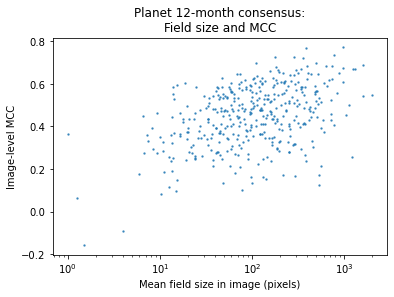

In [105]:
plt.scatter(mean_field_sizes, image_mccs, s=2, alpha=0.7)
plt.xscale('log')
plt.xlabel('Mean field size in image (pixels)')
plt.ylabel('Image-level MCC')
plt.title('Planet 12-month consensus:\nField size and MCC')
plt.show()

In [108]:
from sklearn.linear_model import LinearRegression
reg2 = LinearRegression().fit(np.expand_dims(np.log(np.array(mean_field_sizes)), -1), 
                             np.expand_dims(np.array(image_mccs), -1))
print(reg2.score(np.expand_dims(np.log(np.array(mean_field_sizes)), -1), 
                np.expand_dims(np.array(image_mccs), -1)))
print(reg2.coef_)
print(reg2.intercept_)

0.1849934382545244
[[0.04997062]]
[0.21707524]


### Airbus

In [6]:
def get_image_mccs(extent_folder_name, pred_folder_name, image_ids, threshold=0.5):

    image_mccs = []
    mean_field_sizes = []
    std_field_sizes = []

    for image_id in image_ids:
        extent = imageio.imread(os.path.join(extent_folder_name, 'airbus_geowiki_C{}.png'.format(image_id)))
        pred = np.load(os.path.join(pred_folder_name,
                                    'extent_predictions',
                                    'airbus_geowiki_C{}.npy'.format(image_id)))

        mask = get_mask(extent)
        mask_flat = mask.flatten()

        indices = np.where(mask_flat == 1)[0]
        extent_flat = extent.flatten()
        field_and_border = extent_flat[indices]

        pred_flat = pred.flatten()
        prediction = pred_flat[indices]
        prediction = np.array(prediction > threshold, dtype=np.uint8)

        mcc = matthews_corrcoef(field_and_border, prediction)
        image_mccs.append(mcc)

        n_components, numbered = cv2.connectedComponents(extent)
        field_sizes = []
        for i in range(1, n_components):
            one_field = np.array(numbered == i, dtype=np.uint8)
            field_sizes.append(np.sum(one_field))
        mean_field_size = np.mean(field_sizes)
        std_field_size = np.std(field_sizes)
        mean_field_sizes.append(mean_field_size)
        std_field_sizes.append(std_field_size)
        
    return image_mccs, mean_field_sizes, std_field_sizes

#### Model fine-tuned on 1x-3x Airbus imagery

In [118]:
fold = 'test'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values
image_mccs_3x, mean_field_sizes_3x, std_field_sizes_3x = get_image_mccs(
    extent_folder_name='../data/general_blockchain/airbus_labels/large/3x_downsample_erosion2px_test/', 
    pred_folder_name='../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/',
    image_ids=image_ids, 
    threshold=0.5)

In [119]:
image_mccs_2x, mean_field_sizes_2x, std_field_sizes_2x = get_image_mccs(
    extent_folder_name='../data/general_blockchain/airbus_labels/large/2x_downsample_erosion1px_test/', 
    pred_folder_name='../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled/',
    image_ids=image_ids, 
    threshold=0.5)

In [120]:
image_mccs_1x, mean_field_sizes_1x, std_field_sizes_1x = get_image_mccs(
    extent_folder_name='../data/general_blockchain/airbus_labels/large/original_test/', 
    pred_folder_name='../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_original/', 
    image_ids=image_ids, 
    threshold=0.5)

/home/swang222/anaconda3/envs/mxnet1.6.0/lib/python3.6/site-packages/numpy/core/_methods.py:217: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
/home/swang222/anaconda3/envs/mxnet1.6.0/lib/python3.6/site-packages/numpy/core/_methods.py:186: RuntimeWarning: invalid value encountered in true_divide
  arrmean, rcount, out=arrmean, casting='unsafe', subok=False)
/home/swang222/anaconda3/envs/mxnet1.6.0/lib/python3.6/site-packages/numpy/core/_methods.py:209: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


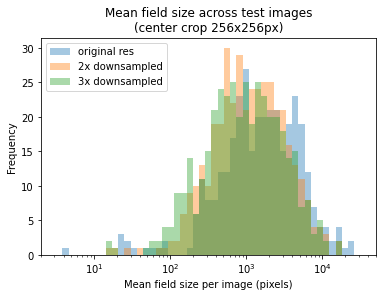

In [141]:
plt.hist(np.array(mean_field_sizes_1x), bins=np.logspace(0.5, 4.5), alpha=0.4)
plt.hist(np.array(mean_field_sizes_2x) * 4, bins=np.logspace(0.5, 4.5), alpha=0.4)
plt.hist(np.array(mean_field_sizes_3x) * 9, bins=np.logspace(0.5, 4.5), alpha=0.4)

plt.legend(['original res', '2x downsampled', '3x downsampled'])
plt.xscale('log')
plt.xlabel('Mean field size per image (pixels)')
plt.ylabel('Frequency')
plt.title('Mean field size across test images\n(center crop 256x256px)')
plt.show()

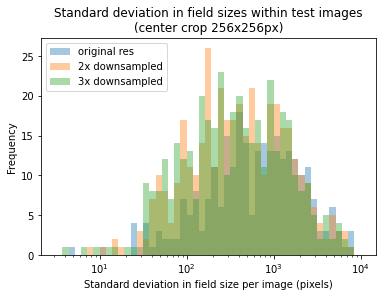

In [137]:
plt.hist(np.array(std_field_sizes_1x), bins=np.logspace(0.5, 4.), alpha=0.4)
plt.hist(np.array(std_field_sizes_2x) * 4, bins=np.logspace(0.5, 4.), alpha=0.4)
plt.hist(np.array(std_field_sizes_3x) * 9, bins=np.logspace(0.5, 4.), alpha=0.4)

plt.legend(['original res', '2x downsampled', '3x downsampled'])
plt.xscale('log')
plt.xlabel('Standard deviation in field size per image (pixels)')
plt.ylabel('Frequency')
plt.title('Standard deviation in field sizes within test images\n(center crop 256x256px)')
plt.show()

In [113]:
np.min(np.log10(np.array(image_field_sizes_3x) * 9))

1.1760912590556813

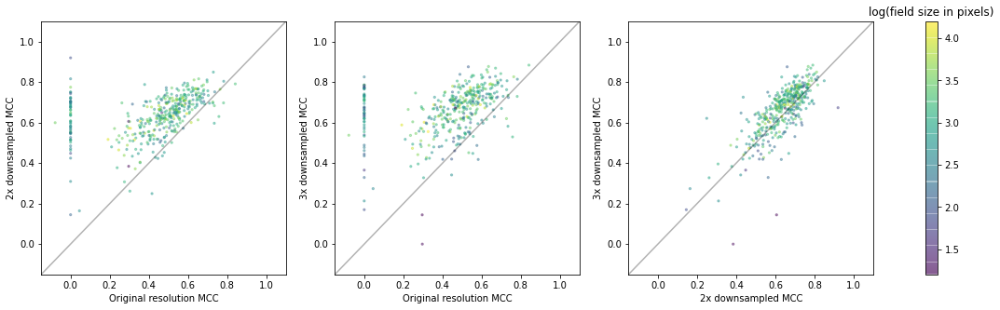

In [149]:
fig, ax = plt.subplots(1, 3, figsize=(20,5))
for i in range(3):
    ax[i].plot([-0.5, 1.5], [-0.5,1.5], color='black', alpha=0.3)
    ax[i].set_xlim([-0.15, 1.1])
    ax[i].set_ylim([-0.15, 1.1])
ax[0].scatter(image_mccs_1x, image_mccs_2x, s=5, alpha=0.4, 
              c=np.log10(np.array(image_field_sizes_2x) * 4), vmin=1.2, vmax=4.2)
ax[0].set_xlabel('Original resolution MCC')
ax[0].set_ylabel('2x downsampled MCC')

ax[1].scatter(image_mccs_1x, image_mccs_3x, s=5, alpha=0.4, 
              c=np.log10(np.array(image_field_sizes_3x) * 9), vmin=1.2, vmax=4.2)
ax[1].set_xlabel('Original resolution MCC')
ax[1].set_ylabel('3x downsampled MCC')

sc = ax[2].scatter(image_mccs_2x, image_mccs_3x, s=5, alpha=0.4, 
                   c=np.log10(np.array(image_field_sizes_3x) * 9), vmin=1.2, vmax=4.2)
ax[2].set_xlabel('2x downsampled MCC')
ax[2].set_ylabel('3x downsampled MCC')

cbar = fig.colorbar(sc, ax=ax[:])
cbar.ax.set_title("log(field size in pixels)")

plt.show()

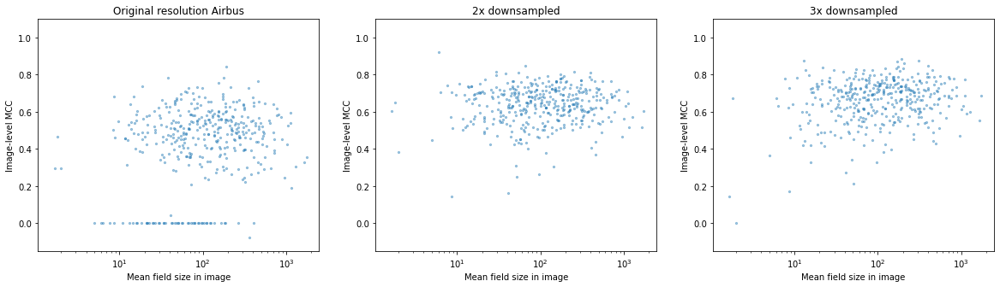

In [145]:
fig, ax = plt.subplots(1, 3, figsize=(20,5))
for i in range(3):
    ax[i].plot([-0.5, 1.5], [-0.5,1.5], color='black', alpha=0.3)
#     ax[i].set_xlim([-0.15, 1.1])
    ax[i].set_xscale('log')
    ax[i].set_ylim([-0.15, 1.1])
    ax[i].set_xlabel('Mean field size in image')
    ax[i].set_ylabel('Image-level MCC')

ax[0].scatter(mean_field_sizes_1x, image_mccs_1x, s=5, alpha=0.4)
ax[0].set_title('Original resolution Airbus')
ax[1].scatter(mean_field_sizes_2x, image_mccs_2x, s=5, alpha=0.4)
ax[1].set_title('2x downsampled')
ax[2].scatter(mean_field_sizes_3x, image_mccs_3x, s=5, alpha=0.4)
ax[2].set_title('3x downsampled')

plt.show()

In [152]:
results_df = pd.DataFrame({
    'image_id': image_ids,
    'MCC_1x': image_mccs_1x,
    'MCC_2x': image_mccs_2x,
    'MCC_3x': image_mccs_3x,
    'field_size_1x': mean_field_sizes_1x,
    'field_size_2x': mean_field_sizes_2x,
    'field_size_3x': mean_field_sizes_3x,
    'std_field_size_1x': std_field_sizes_1x,
    'std_field_size_2x': std_field_sizes_2x,
    'std_field_size_3x': std_field_sizes_3x
})
results_df.head()

,image_id,MCC_1x,MCC_2x,MCC_3x,field_size_1x,field_size_2x,field_size_3x,std_field_size_1x,std_field_size_2x,std_field_size_3x
0,0000,0.550015,0.582212,0.637761,1301.0,509.0,220.8,0.0,312.926189,107.985925
1,0115,0.191540,0.516926,0.588438,34722.0,2703.8,1157.6,0.0,674.041957,281.801774
2,0781,0.405649,0.512919,0.649885,3790.0,158.6,58.6,0.0,106.394737,42.771953
3,0851,0.439795,0.633080,0.710543,1726.0,134.6,46.2,1126.0,12.208194,3.867816
4,0876,0.508810,0.667158,0.645942,688.5,48.8,13.8,4.5,23.709914,8.975522


#### Where original resolution MCC = 0

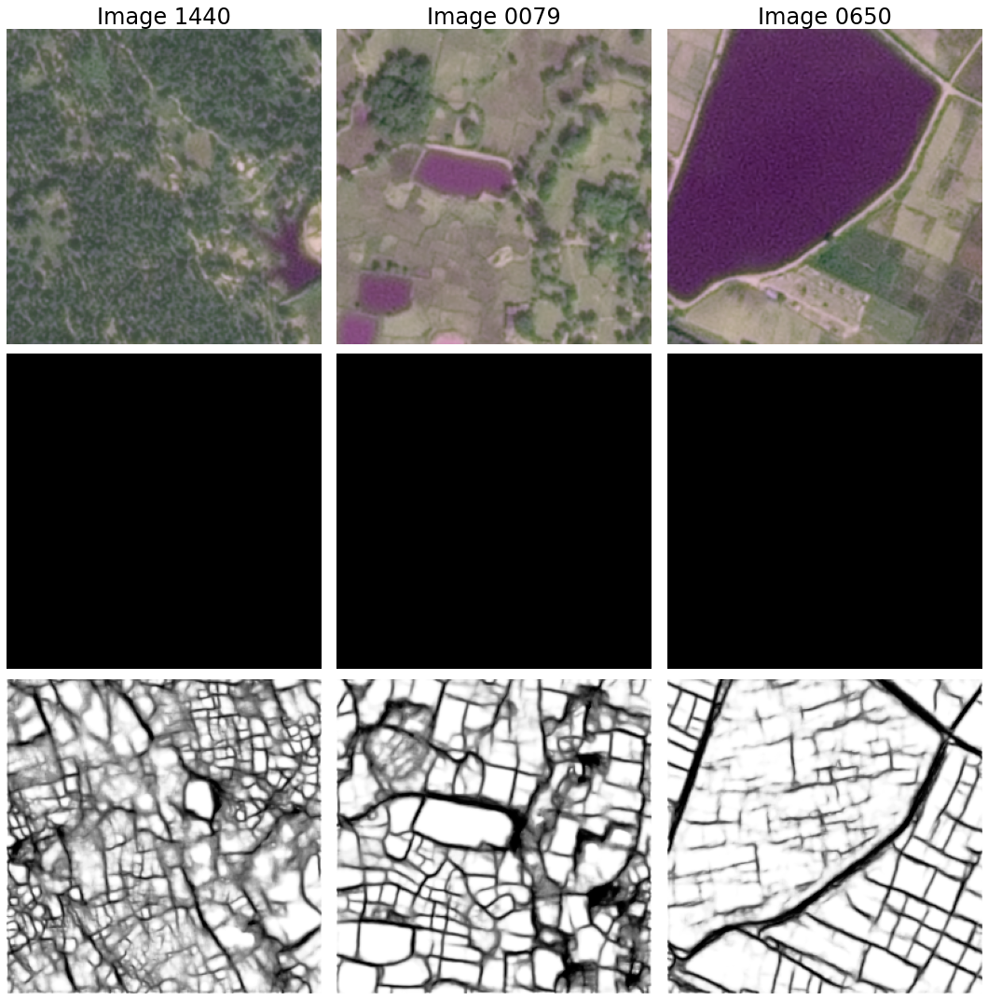

In [176]:
ids_to_plot = ['1440', '0079', '0650']

fig, ax = plt.subplots(3, 3, figsize=(15, 15))

for i in range(3):
    img = imageio.imread('../data/general_blockchain/airbus_false_color/large/original_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[0,i].imshow(img)
    ax[0,i].set_title("Image {}".format(ids_to_plot[i]), fontsize=24)
    
    label = imageio.imread('../data/general_blockchain/airbus_labels/large/original_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[1,i].imshow(label, cmap='Greys_r')
    
    pred = np.load('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_original/extent_predictions/airbus_geowiki_C{}.npy'.format(ids_to_plot[i]))
    ax[2,i].imshow(pred, cmap='Greys_r')
    
for i in range(len(ids_to_plot)):
    for j in range(3):
        ax[j,i].axis('off')
        
plt.tight_layout()
plt.show()

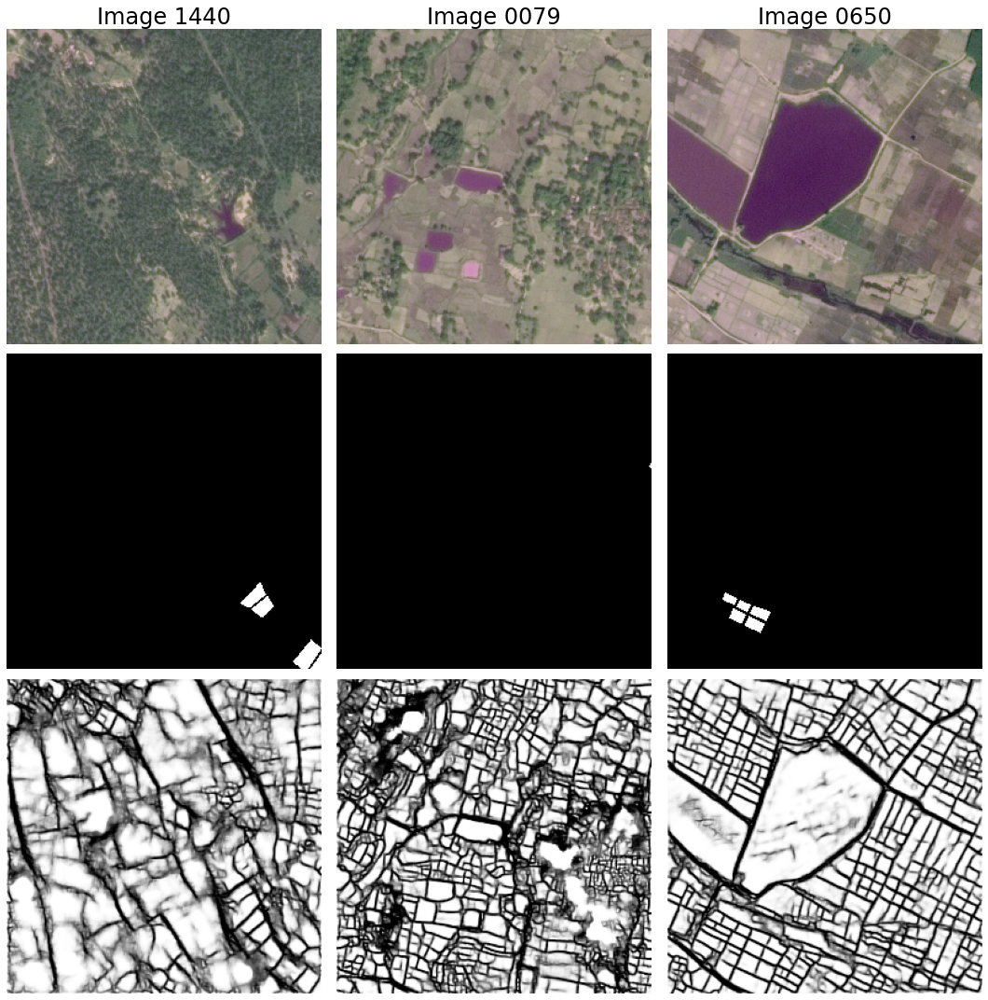

In [175]:
ids_to_plot = ['1440', '0079', '0650']

fig, ax = plt.subplots(3, 3, figsize=(15, 15))

for i in range(3):
    img = imageio.imread('../data/general_blockchain/airbus_false_color/large/2x_downsample_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[0,i].imshow(img)
    ax[0,i].set_title("Image {}".format(ids_to_plot[i]), fontsize=24)
    
    label = imageio.imread('../data/general_blockchain/airbus_labels/large/2x_downsample_erosion1px_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[1,i].imshow(label, cmap='Greys_r')
    
    pred = np.load('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled/extent_predictions/airbus_geowiki_C{}.npy'.format(ids_to_plot[i]))
    ax[2,i].imshow(pred, cmap='Greys_r')
    
for i in range(len(ids_to_plot)):
    for j in range(3):
        ax[j,i].axis('off')
        
plt.tight_layout()
plt.show()

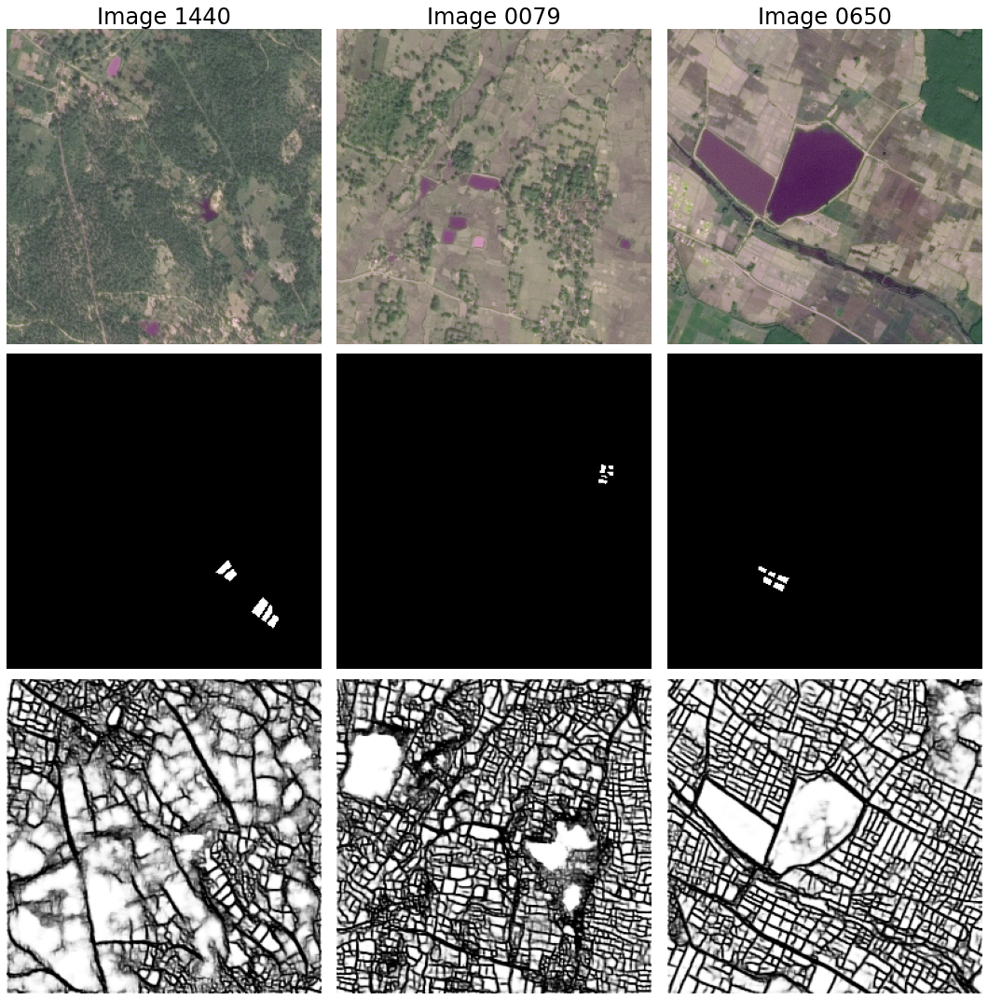

In [177]:
ids_to_plot = ['1440', '0079', '0650']

fig, ax = plt.subplots(3, 3, figsize=(15, 15))

for i in range(3):
    img = imageio.imread('../data/general_blockchain/airbus_false_color/large/3x_downsample_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[0,i].imshow(img)
    ax[0,i].set_title("Image {}".format(ids_to_plot[i]), fontsize=24)
    
    label = imageio.imread('../data/general_blockchain/airbus_labels/large/3x_downsample_erosion2px_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[1,i].imshow(label, cmap='Greys_r')
    
    pred = np.load('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/extent_predictions/airbus_geowiki_C{}.npy'.format(ids_to_plot[i]))
    ax[2,i].imshow(pred, cmap='Greys_r')
    
for i in range(len(ids_to_plot)):
    for j in range(3):
        ax[j,i].axis('off')
        
plt.tight_layout()
plt.show()

#### Where original resolution is better than 3x downsampled

In [172]:
results_df[results_df['MCC_1x'] > (results_df['MCC_3x'] + 0.1)]

,image_id,MCC_1x,MCC_2x,MCC_3x,field_size_1x,field_size_2x,field_size_3x,std_field_size_1x,std_field_size_2x,std_field_size_3x
10,1460,0.757643,0.630139,0.529436,280.0,390.200000,152.600000,203.000000,137.472034,59.436016
61,0075,0.726641,0.702036,0.619724,21.0,828.800000,355.600000,0.000000,367.337665,131.079518
86,0209,0.296785,0.384353,0.000000,73.6,3.714286,2.000000,24.360624,4.299976,0.000000
145,0516,0.446264,0.422846,0.341444,655.0,134.400000,48.800000,379.738726,75.282402,30.857090
147,0518,0.734127,0.597004,0.582098,48.5,221.000000,84.600000,32.500000,136.557680,54.945791
189,0724,0.554693,0.668445,0.447973,1045.2,221.600000,84.800000,184.224211,44.274598,17.197674
253,1098,0.296174,0.606207,0.144423,53.8,6.600000,1.666667,23.412817,3.555278,0.471405
295,1316,0.582208,0.630441,0.417970,501.0,98.000000,22.571429,301.699851,65.711491,26.179911


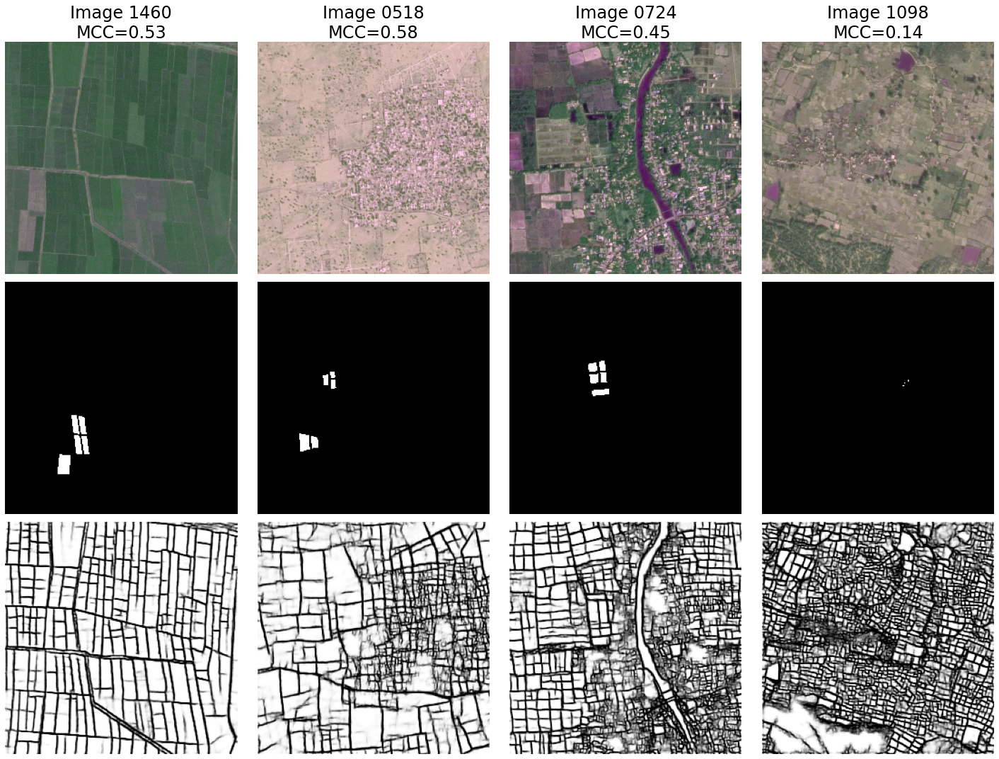

In [183]:
ids_to_plot = ['1460', '0518', '0724', '1098']

fig, ax = plt.subplots(3, 4, figsize=(20, 15))

for i in range(len(ids_to_plot)):
    img = imageio.imread('../data/general_blockchain/airbus_false_color/large/3x_downsample_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[0,i].imshow(img)
    id_mcc = results_df[results_df['image_id'] == ids_to_plot[i]]['MCC_3x'].values[0]
    ax[0,i].set_title("Image {}\nMCC={:0.2f}".format(ids_to_plot[i], id_mcc), fontsize=24)
    
    label = imageio.imread('../data/general_blockchain/airbus_labels/large/3x_downsample_erosion2px_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[1,i].imshow(label, cmap='Greys_r')
    
    pred = np.load('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/extent_predictions/airbus_geowiki_C{}.npy'.format(ids_to_plot[i]))
    ax[2,i].imshow(pred, cmap='Greys_r')
    
for i in range(len(ids_to_plot)):
    for j in range(3):
        ax[j,i].axis('off')
        
plt.tight_layout()
plt.show()

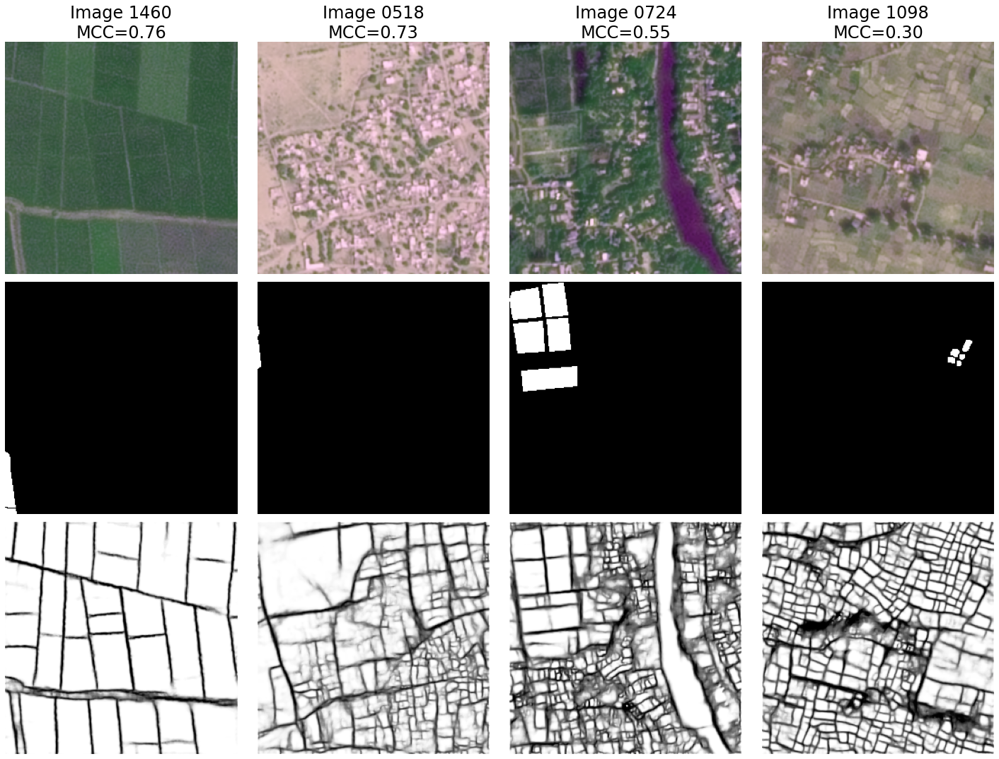

In [184]:
ids_to_plot = ['1460', '0518', '0724', '1098']

fig, ax = plt.subplots(3, 4, figsize=(20, 15))

for i in range(len(ids_to_plot)):
    img = imageio.imread('../data/general_blockchain/airbus_false_color/large/original_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[0,i].imshow(img)
    id_mcc = results_df[results_df['image_id'] == ids_to_plot[i]]['MCC_1x'].values[0]
    ax[0,i].set_title("Image {}\nMCC={:0.2f}".format(ids_to_plot[i], id_mcc), fontsize=24)
    
    label = imageio.imread('../data/general_blockchain/airbus_labels/large/original_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[1,i].imshow(label, cmap='Greys_r')
    
    pred = np.load('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_original/extent_predictions/airbus_geowiki_C{}.npy'.format(ids_to_plot[i]))
    ax[2,i].imshow(pred, cmap='Greys_r')
    
for i in range(len(ids_to_plot)):
    for j in range(3):
        ax[j,i].axis('off')
        
plt.tight_layout()
plt.show()

#### Where 2x downsampled > 3x downsampled

In [186]:
results_df[results_df['MCC_2x'] > (results_df['MCC_3x'] + 0.15)]

,image_id,MCC_1x,MCC_2x,MCC_3x,field_size_1x,field_size_2x,field_size_3x,std_field_size_1x,std_field_size_2x,std_field_size_3x
78,0158,0.000000,0.563163,0.329052,NaN,48.400000,15.800000,NaN,27.774809,9.325235
86,0209,0.296785,0.384353,0.000000,73.6,3.714286,2.000000,24.360624,4.299976,0.000000
189,0724,0.554693,0.668445,0.447973,1045.2,221.600000,84.800000,184.224211,44.274598,17.197674
253,1098,0.296174,0.606207,0.144423,53.8,6.600000,1.666667,23.412817,3.555278,0.471405
294,1310,0.000000,0.920087,0.673722,NaN,20.000000,6.000000,NaN,0.000000,1.095445
295,1316,0.582208,0.630441,0.417970,501.0,98.000000,22.571429,301.699851,65.711491,26.179911
376,1854,0.487058,0.699682,0.530959,262.8,58.200000,18.800000,137.046561,18.861601,6.241795


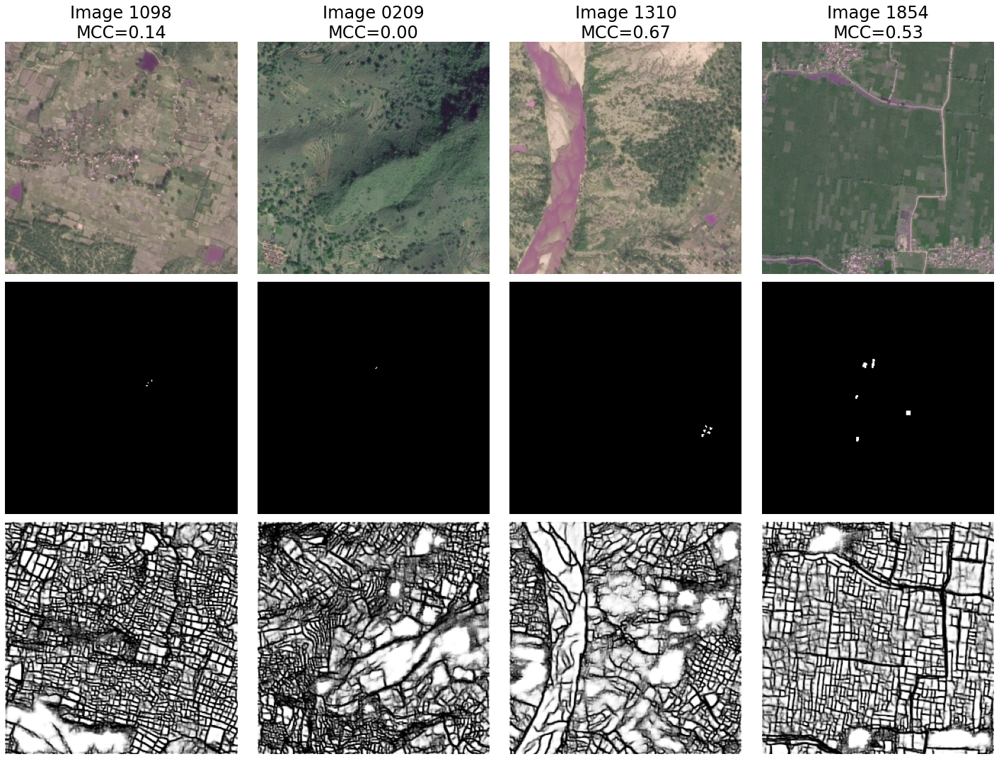

In [187]:
ids_to_plot = ['1098', '0209', '1310', '1854']

fig, ax = plt.subplots(3, 4, figsize=(20, 15))

for i in range(len(ids_to_plot)):
    img = imageio.imread('../data/general_blockchain/airbus_false_color/large/3x_downsample_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[0,i].imshow(img)
    id_mcc = results_df[results_df['image_id'] == ids_to_plot[i]]['MCC_3x'].values[0]
    ax[0,i].set_title("Image {}\nMCC={:0.2f}".format(ids_to_plot[i], id_mcc), fontsize=24)
    
    label = imageio.imread('../data/general_blockchain/airbus_labels/large/3x_downsample_erosion2px_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[1,i].imshow(label, cmap='Greys_r')
    
    pred = np.load('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/extent_predictions/airbus_geowiki_C{}.npy'.format(ids_to_plot[i]))
    ax[2,i].imshow(pred, cmap='Greys_r')
    
for i in range(len(ids_to_plot)):
    for j in range(3):
        ax[j,i].axis('off')
        
plt.tight_layout()
plt.show()

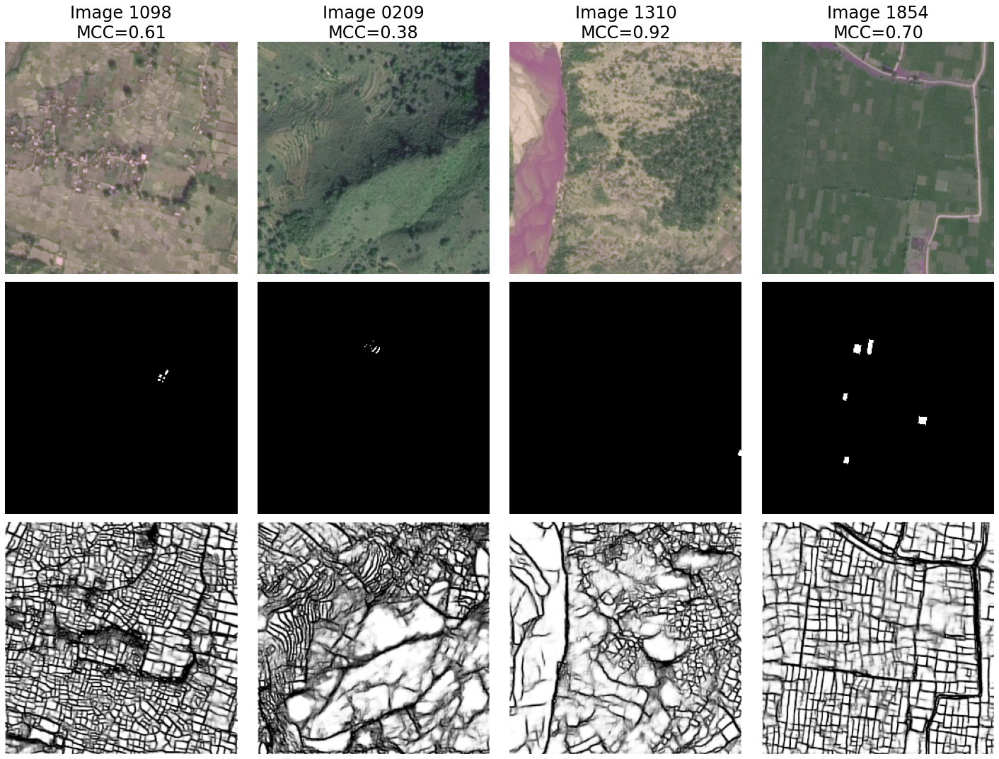

In [188]:
ids_to_plot = ['1098', '0209', '1310', '1854']

fig, ax = plt.subplots(3, 4, figsize=(20, 15))

for i in range(len(ids_to_plot)):
    img = imageio.imread('../data/general_blockchain/airbus_false_color/large/2x_downsample_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[0,i].imshow(img)
    id_mcc = results_df[results_df['image_id'] == ids_to_plot[i]]['MCC_2x'].values[0]
    ax[0,i].set_title("Image {}\nMCC={:0.2f}".format(ids_to_plot[i], id_mcc), fontsize=24)
    
    label = imageio.imread('../data/general_blockchain/airbus_labels/large/2x_downsample_erosion1px_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[1,i].imshow(label, cmap='Greys_r')
    
    pred = np.load('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled/extent_predictions/airbus_geowiki_C{}.npy'.format(ids_to_plot[i]))
    ax[2,i].imshow(pred, cmap='Greys_r')
    
for i in range(len(ids_to_plot)):
    for j in range(3):
        ax[j,i].axis('off')
        
plt.tight_layout()
plt.show()

#### Where 3x downsampled > 2x downsampled

In [189]:
results_df[results_df['MCC_3x'] > (results_df['MCC_2x'] + 0.15)]

,image_id,MCC_1x,MCC_2x,MCC_3x,field_size_1x,field_size_2x,field_size_3x,std_field_size_1x,std_field_size_2x,std_field_size_3x
15,1478,0.469320,0.435738,0.725701,3699.0,147.6,54.0,0.000000,71.756812,29.017236
54,0030,0.547628,0.632214,0.825373,772.0,87.0,86.2,0.000000,43.776706,82.816423
121,0388,0.531511,0.561116,0.750241,336.6,63.8,21.4,93.369374,21.976351,8.260751
180,0688,0.531568,0.660132,0.875808,222.2,43.2,12.8,93.939129,21.254647,6.177378
209,0821,0.000000,0.570034,0.730995,NaN,173.4,72.2,NaN,37.510532,8.634813
230,0955,0.415844,0.249424,0.621209,736.5,146.4,51.8,728.500000,84.077583,33.120386
252,1092,0.421315,0.454263,0.615220,3733.0,164.0,57.4,0.000000,27.393430,9.891410
332,1530,0.000000,0.424617,0.647491,NaN,73.6,25.2,NaN,11.993331,4.955805


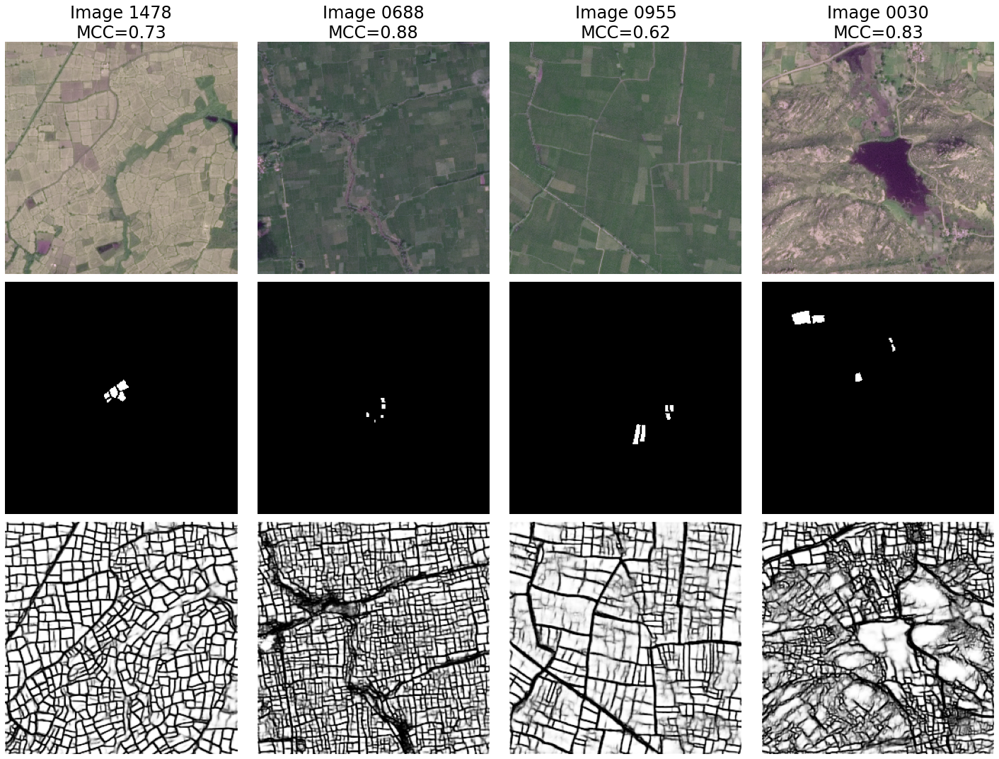

In [190]:
ids_to_plot = ['1478', '0688', '0955', '0030']

fig, ax = plt.subplots(3, 4, figsize=(20, 15))

for i in range(len(ids_to_plot)):
    img = imageio.imread('../data/general_blockchain/airbus_false_color/large/3x_downsample_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[0,i].imshow(img)
    id_mcc = results_df[results_df['image_id'] == ids_to_plot[i]]['MCC_3x'].values[0]
    ax[0,i].set_title("Image {}\nMCC={:0.2f}".format(ids_to_plot[i], id_mcc), fontsize=24)
    
    label = imageio.imread('../data/general_blockchain/airbus_labels/large/3x_downsample_erosion2px_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[1,i].imshow(label, cmap='Greys_r')
    
    pred = np.load('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/extent_predictions/airbus_geowiki_C{}.npy'.format(ids_to_plot[i]))
    ax[2,i].imshow(pred, cmap='Greys_r')
    
for i in range(len(ids_to_plot)):
    for j in range(3):
        ax[j,i].axis('off')
        
plt.tight_layout()
plt.show()

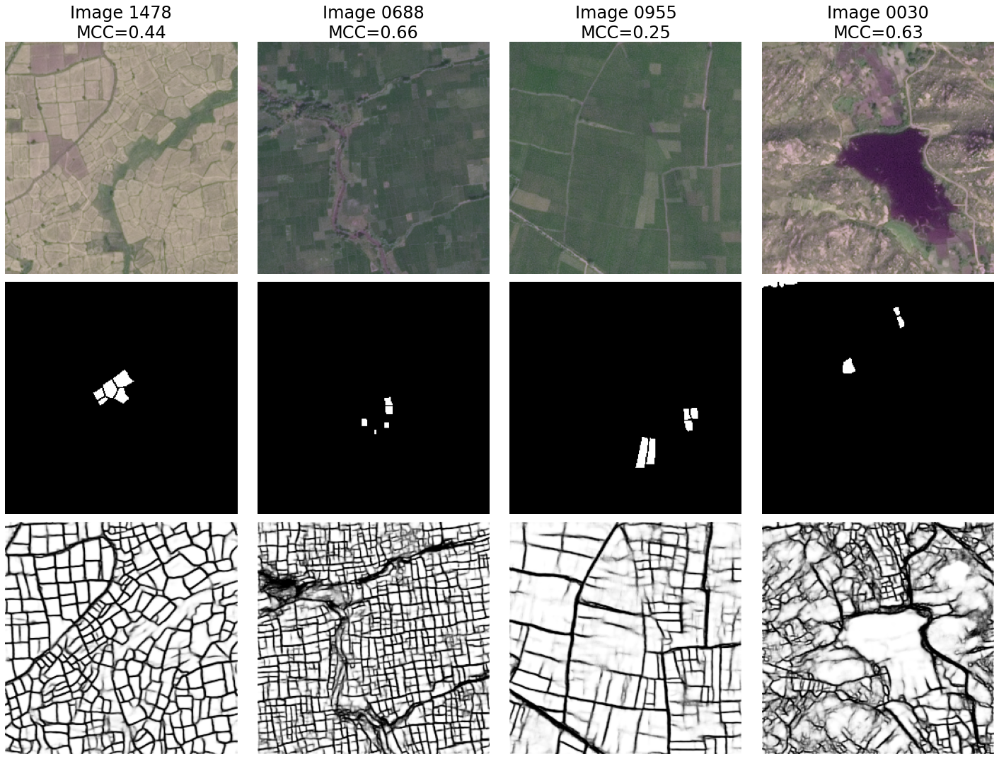

In [191]:
ids_to_plot = ['1478', '0688', '0955', '0030']

fig, ax = plt.subplots(3, 4, figsize=(20, 15))

for i in range(len(ids_to_plot)):
    img = imageio.imread('../data/general_blockchain/airbus_false_color/large/2x_downsample_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[0,i].imshow(img)
    id_mcc = results_df[results_df['image_id'] == ids_to_plot[i]]['MCC_2x'].values[0]
    ax[0,i].set_title("Image {}\nMCC={:0.2f}".format(ids_to_plot[i], id_mcc), fontsize=24)
    
    label = imageio.imread('../data/general_blockchain/airbus_labels/large/2x_downsample_erosion1px_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[1,i].imshow(label, cmap='Greys_r')
    
    pred = np.load('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled/extent_predictions/airbus_geowiki_C{}.npy'.format(ids_to_plot[i]))
    ax[2,i].imshow(pred, cmap='Greys_r')
    
for i in range(len(ids_to_plot)):
    for j in range(3):
        ax[j,i].axis('off')
        
plt.tight_layout()
plt.show()

#### When fields are big, how does original resolution do?

In [202]:
results_df.sort_values('field_size_1x', ascending=False).reset_index(drop=True).iloc[6]

image_id                 0143
MCC_1x               0.425402
MCC_2x               0.561205
MCC_3x               0.613448
field_size_1x           17361
field_size_2x          2394.2
field_size_3x          1011.6
std_field_size_1x         429
std_field_size_2x      1432.6
std_field_size_3x     621.978
Name: 6, dtype: object

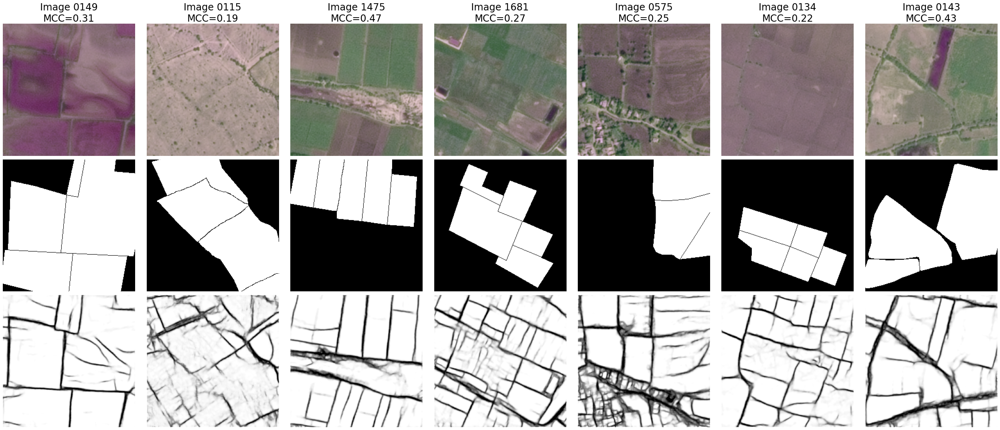

In [203]:
ids_to_plot = ['0149', '0115', '1475', '1681', '0575', '0134', '0143']

fig, ax = plt.subplots(3, 7, figsize=(35, 15))

for i in range(len(ids_to_plot)):
    img = imageio.imread('../data/general_blockchain/airbus_false_color/large/original_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[0,i].imshow(img)
    id_mcc = results_df[results_df['image_id'] == ids_to_plot[i]]['MCC_1x'].values[0]
    ax[0,i].set_title("Image {}\nMCC={:0.2f}".format(ids_to_plot[i], id_mcc), fontsize=24)
    
    label = imageio.imread('../data/general_blockchain/airbus_labels/large/original_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[1,i].imshow(label, cmap='Greys_r')
    
    pred = np.load('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_original/extent_predictions/airbus_geowiki_C{}.npy'.format(ids_to_plot[i]))
    ax[2,i].imshow(pred, cmap='Greys_r')
    
for i in range(len(ids_to_plot)):
    for j in range(3):
        ax[j,i].axis('off')
        
plt.tight_layout()
plt.show()

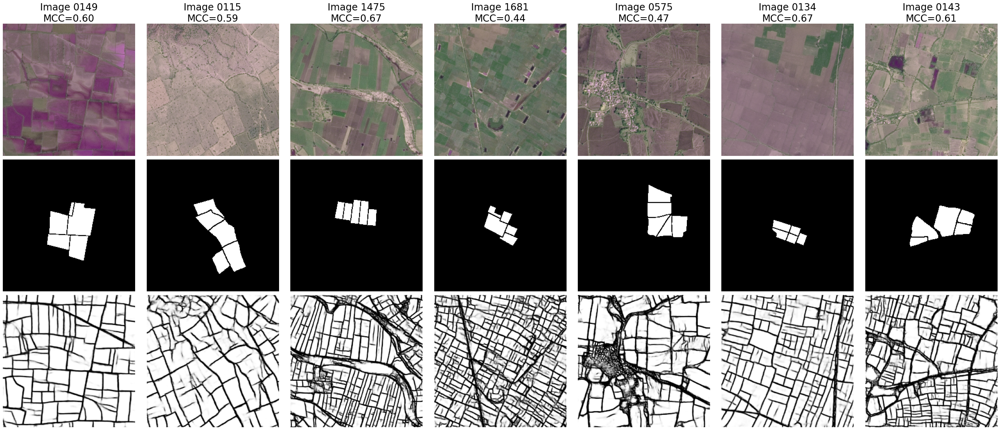

In [204]:
ids_to_plot = ['0149', '0115', '1475', '1681', '0575', '0134', '0143']

fig, ax = plt.subplots(3, 7, figsize=(35, 15))

for i in range(len(ids_to_plot)):
    img = imageio.imread('../data/general_blockchain/airbus_false_color/large/3x_downsample_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[0,i].imshow(img)
    id_mcc = results_df[results_df['image_id'] == ids_to_plot[i]]['MCC_3x'].values[0]
    ax[0,i].set_title("Image {}\nMCC={:0.2f}".format(ids_to_plot[i], id_mcc), fontsize=24)
    
    label = imageio.imread('../data/general_blockchain/airbus_labels/large/3x_downsample_erosion2px_test/airbus_geowiki_C{}.png'.format(ids_to_plot[i]))
    ax[1,i].imshow(label, cmap='Greys_r')
    
    pred = np.load('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/extent_predictions/airbus_geowiki_C{}.npy'.format(ids_to_plot[i]))
    ax[2,i].imshow(pred, cmap='Greys_r')
    
for i in range(len(ids_to_plot)):
    for j in range(3):
        ax[j,i].axis('off')
        
plt.tight_layout()
plt.show()

## MCC at field level

### Planet consensus

In [71]:
# pred_folder_name = 'fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_2x-3x-downsampled_allfields_n6759/consensus'
pred_folder_name = 'fractal-resunet_12month-separate_nfilter-32_bs-8_lr-0.001_2x-3x_downsampled_finetuned/consensus'

field_mccs = []
field_sizes = []

for image_id in image_ids:
    extent = imageio.imread('../data/planet/india/GeneralBlockchain/extent_labels_test/{}.png'.format(image_id))
    pred = np.load(os.path.join('../results/india/GeneralBlockchain/', 
                                pred_folder_name,
                                'extent_predictions',
                                '{}.npy'.format(image_id)))
    n_components, numbered = cv2.connectedComponents(extent)
    for i in range(1, n_components):
        one_field = np.array(numbered == i, dtype=np.uint8)
        one_field_flat = one_field.flatten()

        mask = get_mask(one_field)
        mask_flat = mask.flatten()

        indices = np.where(mask_flat == 1)[0]
        field_and_border = one_field_flat[indices]

        pred_flat = pred.flatten()
        prediction = pred_flat[indices]
        prediction = np.array(prediction > 0.5, dtype=np.uint8)

        mcc = matthews_corrcoef(field_and_border, prediction)
        field_mccs.append(mcc)

        size = np.sum(one_field)
        field_sizes.append(size)

/home/swang222/anaconda3/envs/mxnet1.6.0/lib/python3.6/site-packages/sklearn/metrics/_classification.py:846: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


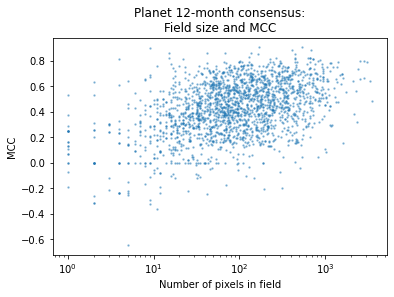

In [76]:
plt.scatter(field_sizes, field_mccs, s=2, alpha=0.4)
plt.xscale('log')
plt.xlabel('Number of pixels in field')
plt.ylabel('MCC')
plt.title('Planet 12-month consensus:\nField size and MCC')
plt.show()

In [111]:
from sklearn.linear_model import LinearRegression
reg = LinearRegression().fit(np.expand_dims(np.log(np.array(field_sizes)), -1), 
                             np.expand_dims(np.array(field_mccs), -1))
print(reg.score(np.expand_dims(np.log(np.array(field_sizes)), -1), 
                np.expand_dims(np.array(field_mccs), -1)))
print(reg.coef_)
print(reg.intercept_)

0.17995360285787
[[0.06546948]]
[0.13540835]


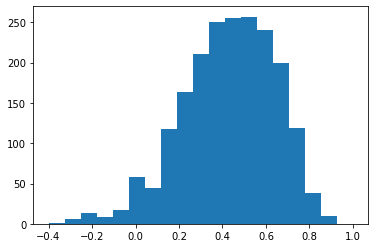

In [72]:
plt.hist(field_mccs, bins=np.linspace(-0.4, 1.0, 20))
plt.show()

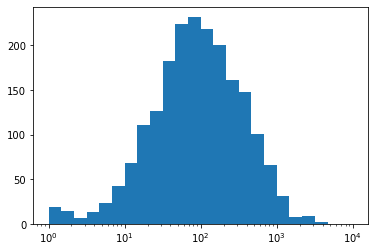

In [73]:
plt.hist(field_sizes, bins=np.logspace(0, 4, 25))
plt.xscale('log')
plt.show()

### Airbus

#### Trained on 3x downsampled

In [14]:
pred_folder_name = 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/'

field_mccs = []
field_sizes = []

for image_id in image_ids:
    extent = imageio.imread('../data/general_blockchain/airbus_labels/large/3x_downsample_erosion2px_test/airbus_geowiki_C{}.png'.format(image_id))
    pred = np.load(os.path.join('../results/india/GeneralBlockchain/', 
                                pred_folder_name,
                                'extent_predictions',
                                'airbus_geowiki_C{}.npy'.format(image_id)))
    n_components, numbered = cv2.connectedComponents(extent)
    for i in range(1, n_components):
        one_field = np.array(numbered == i, dtype=np.uint8)
        one_field_flat = one_field.flatten()

        mask = get_mask(one_field)
        mask_flat = mask.flatten()

        indices = np.where(mask_flat == 1)[0]
        field_and_border = one_field_flat[indices]

        pred_flat = pred.flatten()
        prediction = pred_flat[indices]
        prediction = np.array(prediction > 0.5, dtype=np.uint8)

        mcc = matthews_corrcoef(field_and_border, prediction)
        field_mccs.append(mcc)

        size = np.sum(one_field)
        field_sizes.append(size)

/home/swang222/anaconda3/envs/mxnet1.6.0/lib/python3.6/site-packages/sklearn/metrics/_classification.py:846: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


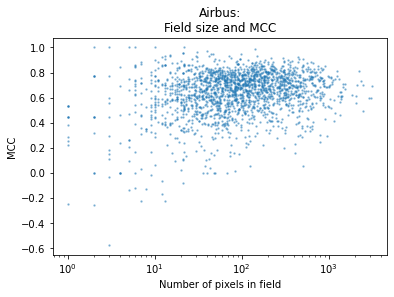

In [15]:
plt.scatter(field_sizes, field_mccs, s=2, alpha=0.4)
plt.xscale('log')
plt.xlabel('Number of pixels in field')
plt.ylabel('MCC')
plt.title('Airbus:\nField size and MCC')
plt.show()

In [17]:
from sklearn.linear_model import LinearRegression
reg = LinearRegression().fit(np.expand_dims(np.log(np.array(field_sizes)), -1), 
                             np.expand_dims(np.array(field_mccs), -1))
print(reg.score(np.expand_dims(np.log(np.array(field_sizes)), -1), 
                np.expand_dims(np.array(field_mccs), -1)))
print(reg.coef_)
print(reg.intercept_)

0.061092767643242674
[[0.03344115]]
[0.48430336]


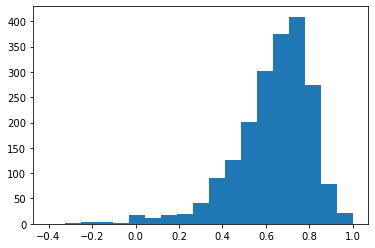

In [16]:
plt.hist(field_mccs, bins=np.linspace(-0.4, 1.0, 20))
plt.show()

## IoU at field level

In [2]:
def InstSegm(extent, boundary, t_ext=0.4, t_bound=0.2):
    """
    INPUTS:
    extent : extent prediction
    boundary : boundary prediction
    t_ext : threshold for extent
    t_bound : threshold for boundary
    OUTPUT:
    instances
    """

    # Threshold extent mask
    ext_binary = np.uint8(extent >= t_ext)

    # Artificially create strong boundaries for
    # pixels with non-field labels
    input_hws = np.copy(boundary)
    input_hws[ext_binary == 0] = 1

    # Create the directed graph
    size = input_hws.shape[:2]
    graph = hg.get_8_adjacency_graph(size)
    edge_weights = hg.weight_graph(
        graph,
        input_hws,
        hg.WeightFunction.mean
    )

    tree, altitudes = hg.watershed_hierarchy_by_dynamics(
        graph,
        edge_weights
    )
    
    # Get individual fields
    # by cutting the graph using altitude
    instances = hg.labelisation_horizontal_cut_from_threshold(
        tree,
        altitudes,
        threshold=t_bound)
    
    instances[ext_binary == 0] = -1

    return instances

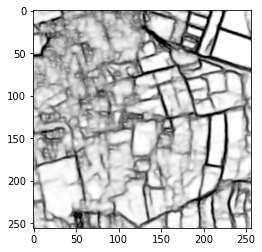

In [6]:
plt.imshow(img, cmap='Greys_r')
plt.show()

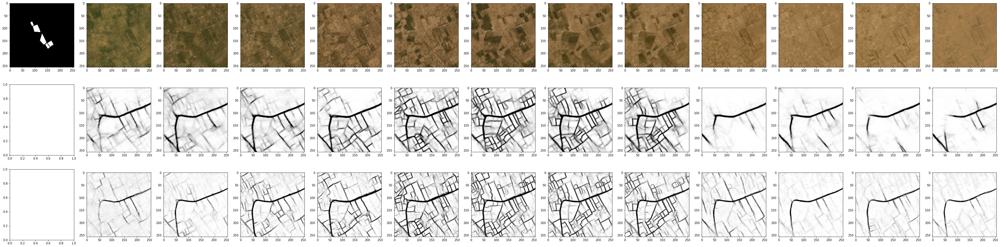

In [125]:
# directly applying France original resolution vs. 2x+3x downsampled
image_id = '0013'
months = ['2020_{}'.format(str(x).zfill(2)) for x in range(8, 13)] + \
         ['2021_{}'.format(str(x).zfill(2)) for x in range(1, 8)]
fig, ax = plt.subplots(3, 13, figsize=(65,15))
label = imageio.imread('../data/planet/india/GeneralBlockchain/extent_labels_test/{}.png'.format(image_id))
ax[0,0].imshow(label, cmap='Greys_r')
for m, month in enumerate(months):
    im = imageio.imread('../data/planet/india/GeneralBlockchain/monthly_mosaics_renamed_clipped_merged_test/{}/{}_{}.tif'.format(month, image_id, month))
    img1 = np.load('../results/india/GeneralBlockchain/fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_1x-downsampled_allfields_n6759/{}/extent_predictions/{}_{}.npy'.format(month, image_id, month))
    img2 = np.load('../results/india/GeneralBlockchain/fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_2x-3x-downsampled_allfields_n6759/{}/extent_predictions/{}_{}.npy'.format(month, image_id, month))

    ax[0,m+1].imshow(im, cmap='Greys_r')
    ax[1,m+1].imshow(img1, cmap='Greys_r')
    ax[2,m+1].imshow(img2, cmap='Greys_r')
plt.show()

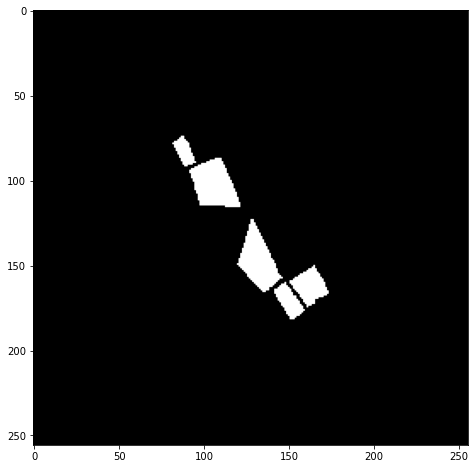

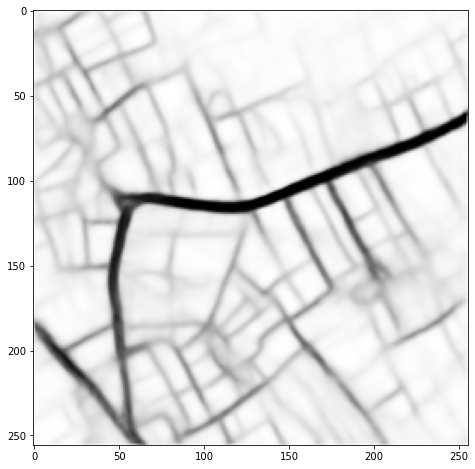

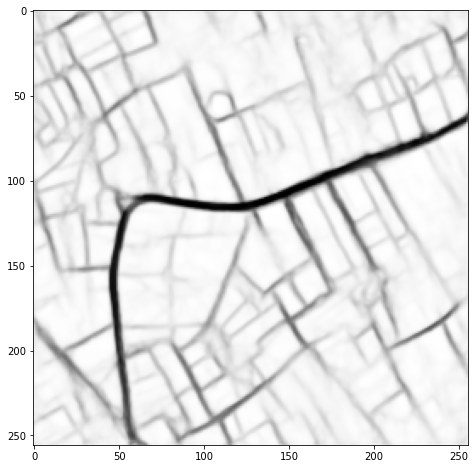

In [126]:
# directly applying France original resolution vs. 2x+3x downsampled
image_id = '0013'
img1 = np.load('../results/india/GeneralBlockchain/fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_1x-downsampled_allfields_n6759/consensus/extent_predictions/{}.npy'.format(image_id))
img2 = np.load('../results/india/GeneralBlockchain/fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_2x-3x-downsampled_allfields_n6759/consensus/extent_predictions/{}.npy'.format(image_id))
label = imageio.imread('../data/planet/india/GeneralBlockchain/extent_labels_test/{}.png'.format(image_id))

fig, ax = plt.subplots(1, 1, figsize=(8,8))
plt.imshow(label, cmap='Greys_r')
plt.show()

fig, ax = plt.subplots(1, 1, figsize=(8,8))
plt.imshow(img1, cmap='Greys_r')
plt.show()

fig, ax = plt.subplots(1, 1, figsize=(8,8))
plt.imshow(img2, cmap='Greys_r')
plt.show()

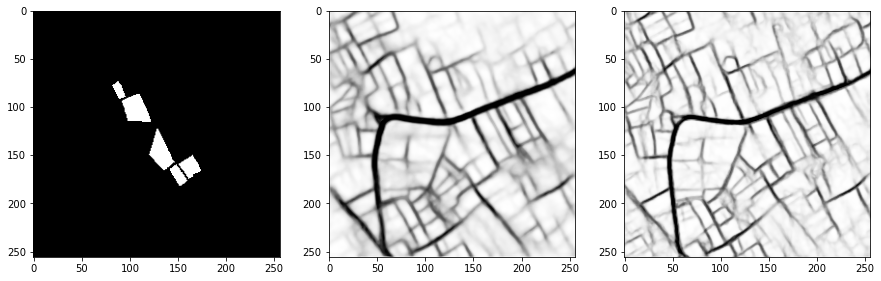

In [134]:
# directly applying France original resolution vs. 2x+3x downsampled
image_id = '0013'
img1 = np.load('../results/india/GeneralBlockchain/fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_1x-downsampled_allfields_n6759/consensus_OctDecFeb/extent_predictions/{}.npy'.format(image_id))
img2 = np.load('../results/india/GeneralBlockchain/fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_2x-3x-downsampled_allfields_n6759/consensus_OctDecFeb/extent_predictions/{}.npy'.format(image_id))
label = imageio.imread('../data/planet/india/GeneralBlockchain/extent_labels_test/{}.png'.format(image_id))

fig, ax = plt.subplots(1, 3, figsize=(15,5))
ax[0].imshow(label, cmap='Greys_r')
ax[1].imshow(img1, cmap='Greys_r')
ax[2].imshow(img2, cmap='Greys_r')
plt.show()